# **Part 2 - NHL Entry Draft**

---


**Phase 1 - Data Import**

In [144]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [8,6]
sns.set()

SEED = 1

#import data and create X & y sets
df = pd.read_csv('Member.csv', encoding = "ISO-8859-1")
df = pd.get_dummies(df)
df

,HasCAM_CSI,Age,Tenure,HasDemand,DemandBalance,HasConsumerMortgage,ConsumerMortgageRemainingBalance,HasConsumerLoanProduct,HasCreditCard,Driver1,...,ConexusDebtShare_80% - 99%,ConexusDebtShare_No Debt,ConexusDebtShare_No TU Loan Data,LastContacted_365+ days,LastContacted_Last 180 days,LastContacted_Last 270 days,LastContacted_Last 30 days,LastContacted_Last 365 days,LastContacted_Last 90 days,LastContacted_Never
0,0,34,30,1,15010.93,1,-197179.54,1,1,66,...,0,0,0,0,0,0,1,0,0,0
1,1,51,29,1,489104.48,0,0.00,0,0,58,...,0,0,0,0,0,0,0,0,1,0
2,0,43,32,1,6495.45,0,0.00,0,0,33,...,0,0,0,0,0,1,0,0,0,0
3,0,78,52,1,2689.43,0,0.00,1,0,41,...,0,0,0,0,0,1,0,0,0,0
4,0,31,18,0,141.08,0,0.00,1,0,-1,...,0,0,0,0,0,0,0,0,0,1
5,0,62,29,1,21.85,0,0.00,0,0,-1,...,0,0,0,0,0,0,0,0,0,1
6,0,63,36,1,1661.24,0,0.00,0,0,-1,...,0,0,0,0,0,0,0,0,0,1
7,0,41,28,1,532.99,0,0.00,1,0,58,...,0,0,0,1,0,0,0,0,0,0
8,0,74,29,1,216.91,0,0.00,0,0,58,...,0,0,1,0,0,0,0,0,0,1
9,1,66,21,1,81070.25,0,0.00,1,0,66,...,0,0,0,1,0,0,0,0,0,0


In [106]:
print(__doc__)

from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit


def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    """
    Generate a simple plot of the test and training learning curve.

    Parameters
    ----------
    estimator : object type that implements the "fit" and "predict" methods
        An object of that type which is cloned for each validation.

    title : string
        Title for the chart.

    X : array-like, shape (n_samples, n_features)
        Training vector, where n_samples is the number of samples and
        n_features is the number of features.

    y : array-like, shape (n_samples) or (n_samples, n_features), optional
        Target relative to X for classification or regression;
        None for unsupervised learning.

    ylim : tuple, shape (ymin, ymax), optional
        Defines minimum and maximum yvalues plotted.

    cv : int, cross-validation generator or an iterable, optional
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:
          - None, to use the default 3-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, optional (default=None)
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like, shape (n_ticks,), dtype float or int
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the dtype is float, it is regarded as a
        fraction of the maximum size of the training set (that is determined
        by the selected validation method), i.e. it has to be within (0, 1].
        Otherwise it is interpreted as absolute sizes of the training sets.
        Note that for classification the number of samples usually have to
        be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes, scoring="f1")
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

Automatically created module for IPython interactive environment


**Phase 2 - Data Preprocessing**

---



In [145]:
#rget rid of three extremely uncorrelated features
#df = df.drop(['TotalQOC', 'Top10Team', 'Import'], axis=1)
y = df.iloc[:,0]
X = df.iloc[:,2:]
X.head()
y.shape

(116050,)

In [108]:
#validate the new correlation matrix to ensure relevancy of remaining features versus response 
corr = df.corr()
corr.style.background_gradient()

In [164]:
#split data into 85% train, 15% test
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=SEED)
df = pd.read_csv('Member.csv', encoding = "ISO-8859-1")
df = pd.get_dummies(df)
df = df.sample(frac=0.05, replace=False)
y = df.iloc[:,0]
y = y.reset_index(drop = True)
X = df.iloc[:,1:]
from sklearn.preprocessing import StandardScaler

#instantiate a scalar
scaler = StandardScaler()

# Fit only to the training data
scaler.fit(X)

# Now apply the transformations to the data:
X_scale = scaler.transform(X)
X_scale.shape

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\data.py:617: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:18: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by StandardScaler.


(5802, 52)

In [110]:
#create function to visualize confusion matrix
# from: https://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
import itertools

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

In [111]:
print(__doc__)

from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit


def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    """
    Generate a simple plot of the test and training learning curve.

    Parameters
    ----------
    estimator : object type that implements the "fit" and "predict" methods
        An object of that type which is cloned for each validation.

    title : string
        Title for the chart.

    X : array-like, shape (n_samples, n_features)
        Training vector, where n_samples is the number of samples and
        n_features is the number of features.

    y : array-like, shape (n_samples) or (n_samples, n_features), optional
        Target relative to X for classification or regression;
        None for unsupervised learning.

    ylim : tuple, shape (ymin, ymax), optional
        Defines minimum and maximum yvalues plotted.

    cv : int, cross-validation generator or an iterable, optional
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:
          - None, to use the default 3-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, optional (default=None)
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like, shape (n_ticks,), dtype float or int
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the dtype is float, it is regarded as a
        fraction of the maximum size of the training set (that is determined
        by the selected validation method), i.e. it has to be within (0, 1].
        Otherwise it is interpreted as absolute sizes of the training sets.
        Note that for classification the number of samples usually have to
        be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes, scoring="f1")
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

Automatically created module for IPython interactive environment


**Phase 3 - Raw Clustering**

---



[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.034s...
[t-SNE] Computed neighbors for 5802 samples in 4.390s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 2.322378
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.899315
[t-SNE] KL divergence after 500 iterations: 1.637101
[[ 28.499033  -12.389448 ]
 [ -2.9722157 -16.436089 ]
 [-24.636703   11.892861 ]
 ...
 [ 14.672625  -10.986903 ]
 [-22.432783   -8.443817 ]
 [-17.564037   38.779583 ]]


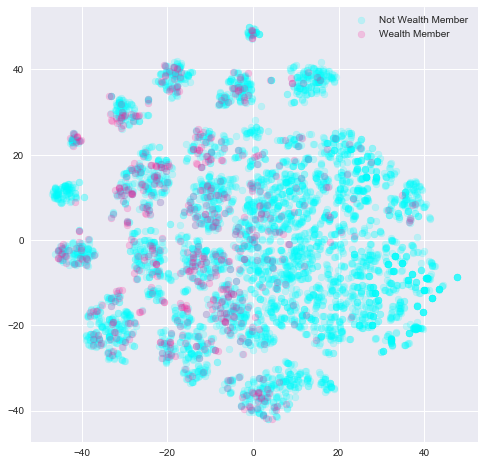

In [30]:
#visualize in 2D using TSNE
import time
import matplotlib.pyplot as plt

from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(X_scale)
print(tsne_results)

# Create the scatter
labels=['Not Wealth Member','Wealth Member']
colours=['aqua','deeppink']
#unique = list(set(df.iloc[:,0]))
plt.figure( figsize=(8,8) )
y = y.reset_index(drop = True)
for i in range(2):#enumerate(unique):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if y[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if y[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.2)
plt.legend()

In [112]:
#KMeans on Raw Data
from sklearn.cluster import KMeans

km_raw = KMeans(n_clusters=2, random_state=0).fit(X_scale)
km_raw.labels_

array([1, 1, 0, ..., 0, 0, 0])

Text(0.5,1,'Elbow Curve of Inertia by # of KMeans Clusters')

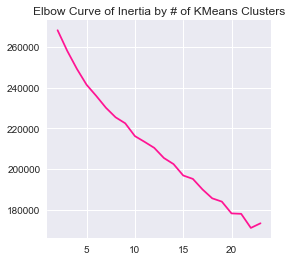

In [113]:
distorsions = []
for k in range(2, 24):
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(X_scale)
    distorsions.append(kmeans.inertia_)

fig = plt.figure(figsize=(4, 4))
plt.plot(range(2, 24), distorsions, c="deeppink")
#plt.grid(True)
plt.title('Elbow Curve of Inertia by # of KMeans Clusters')


Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.09179976517799078
For n_clusters = 3 The average silhouette_score is : 0.09451325687866181
For n_clusters = 4 The average silhouette_score is : 0.05954168493308828
For n_clusters = 5 The average silhouette_score is : 0.06411126938245211
For n_clusters = 6 The average silhouette_score is : 0.058435583649133135
For n_clusters = 7 The average silhouette_score is : 0.05896129429285708
For n_clusters = 8 The average silhouette_score is : 0.07137436935842659
For n_clusters = 9 The average silhouette_score is : 0.06994392418760408
For n_clusters = 10 The average silhouette_score is : 0.08257224330324643
For n_clusters = 11 The average silhouette_score is : 0.07251593735852993
For n_clusters = 12 The average silhouette_score is : 0.0618345422668557
For n_clusters = 13 The average silhouette_score is : 0.06309986091017791
For n_clusters = 14 The average silhouette_score is : 0

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


For n_clusters = 22 The average silhouette_score is : 0.09123057939877889


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


For n_clusters = 23 The average silhouette_score is : 0.08344160133581563


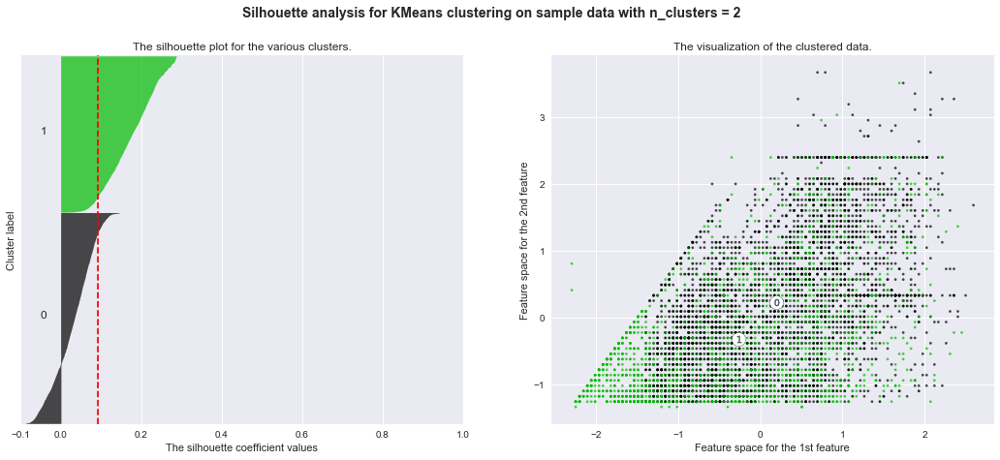

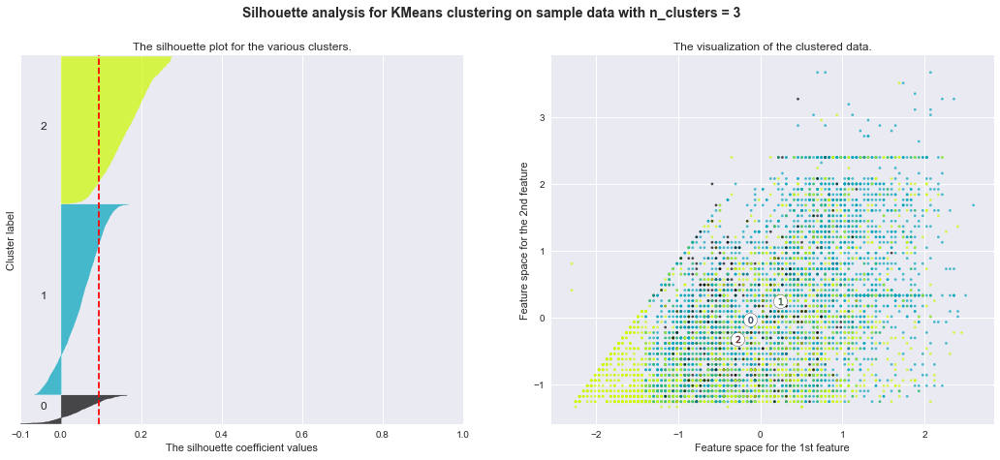

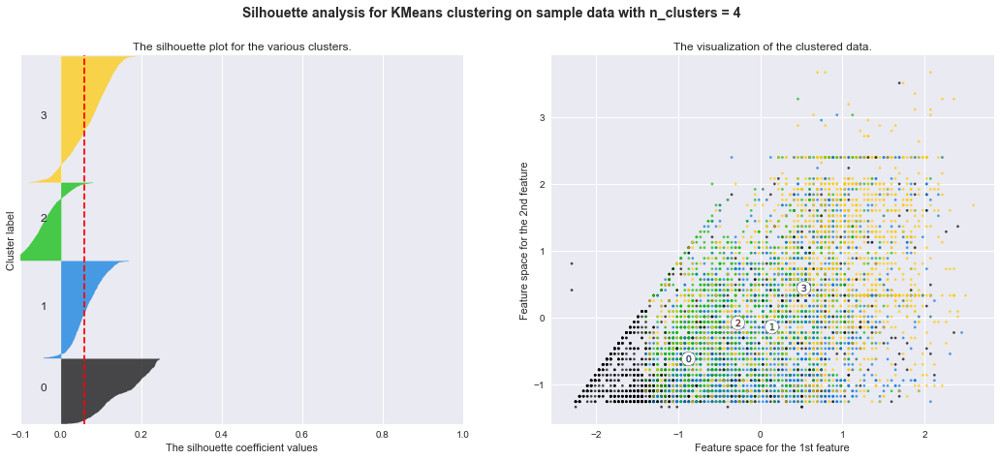

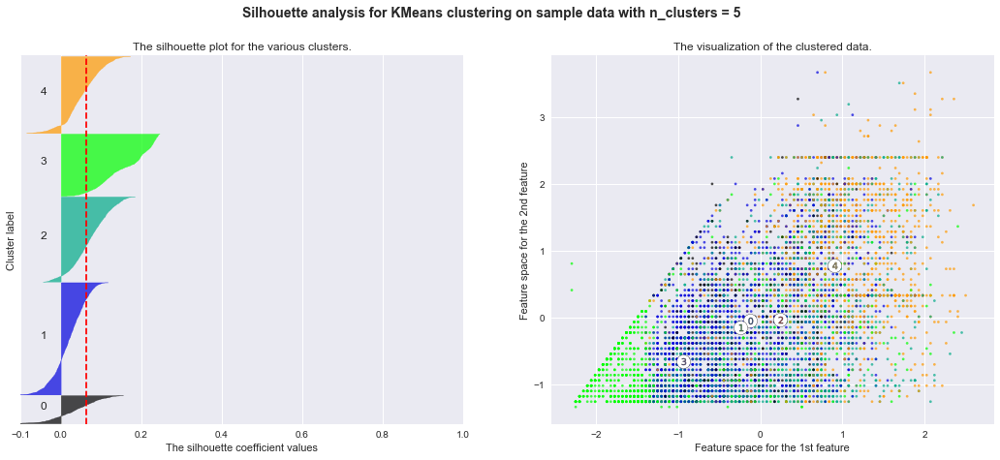

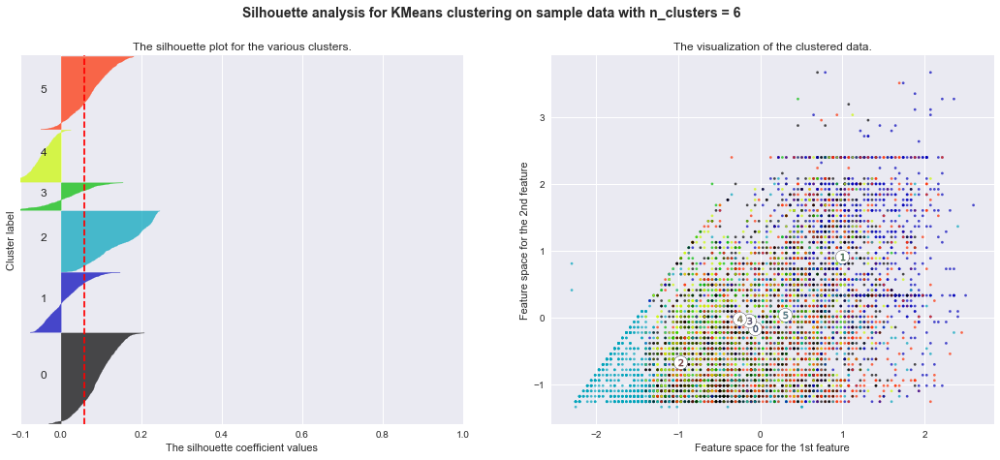

...

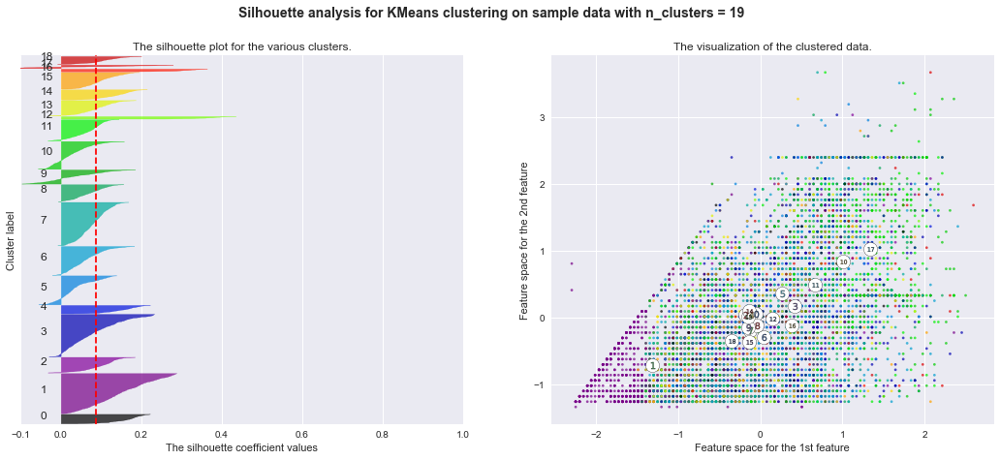

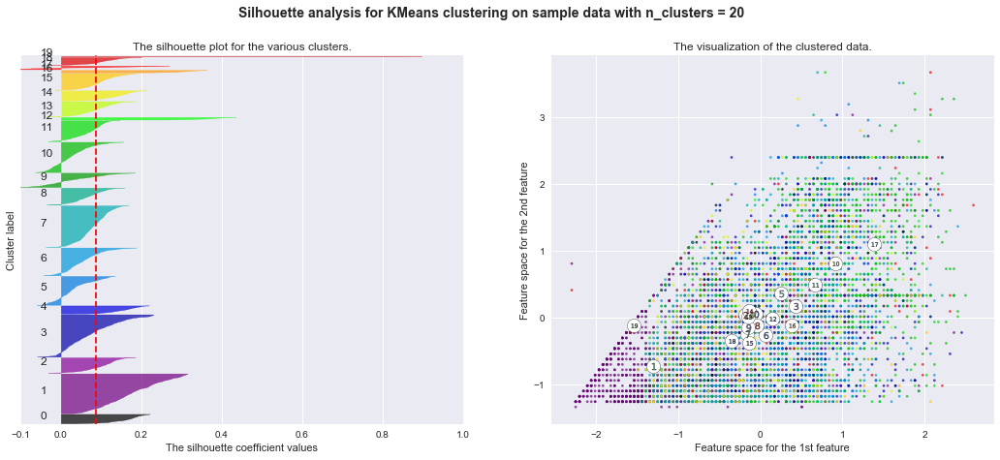

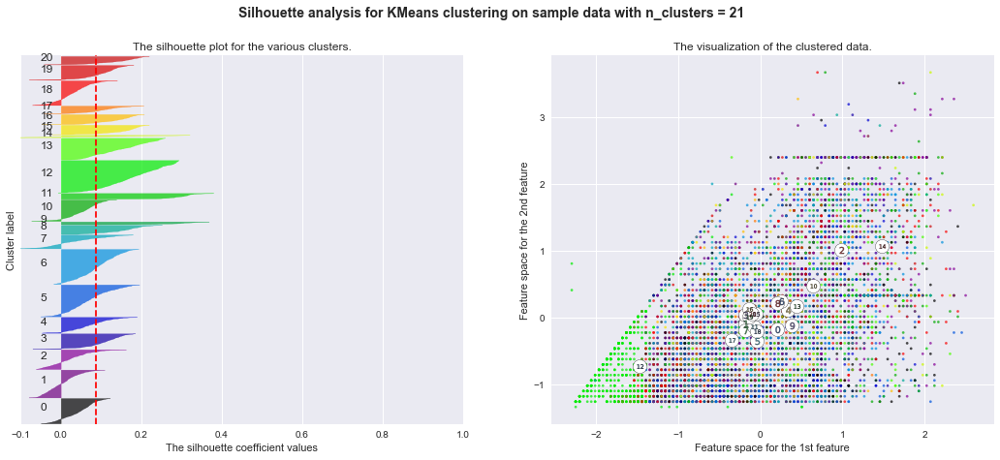

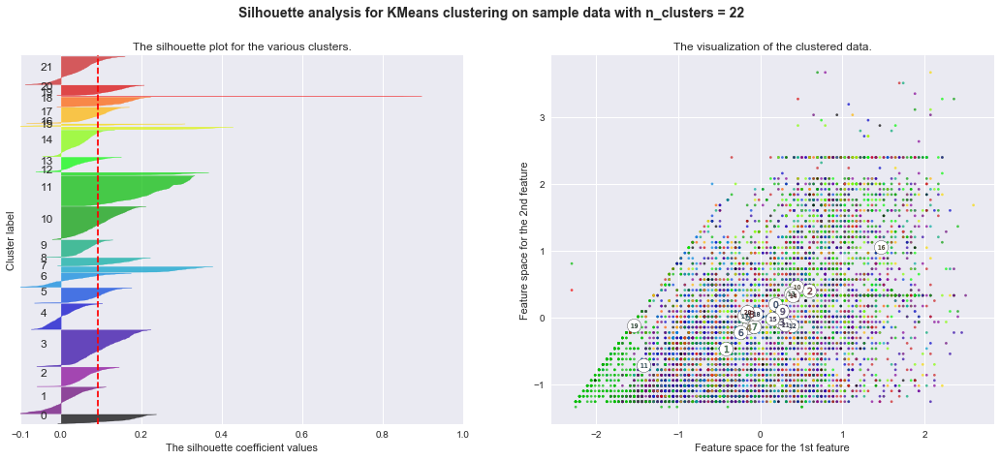

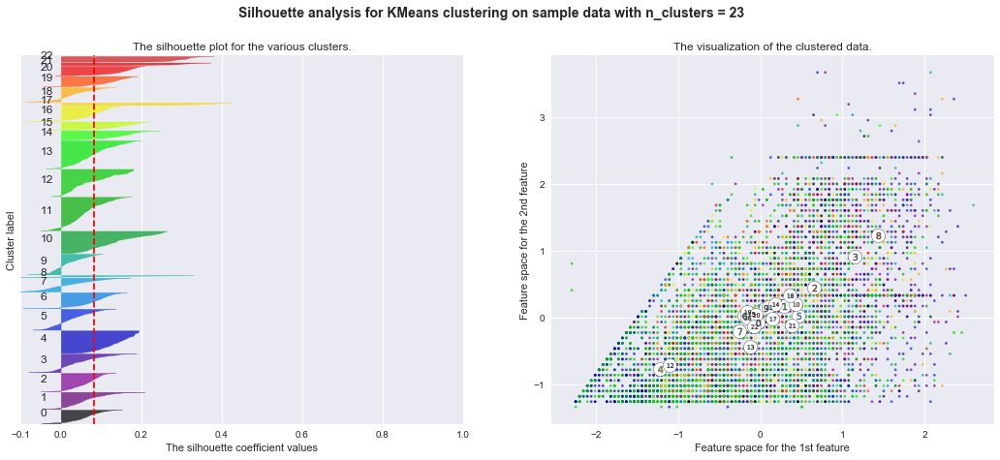

In [114]:
from __future__ import print_function

from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = range(2,24)
silscores= []
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X_scale)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X_scale, cluster_labels)
    silscores.append(silhouette_avg)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X_scale, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X_scale[:, 0], X_scale[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

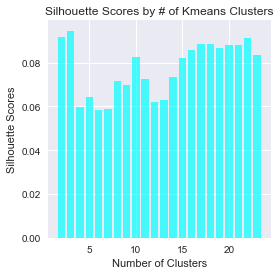

In [127]:
plt.figure( figsize=(4,4))
plt.bar(range(2,24), silscores, align='center', alpha=0.7, color="cyan")
#plt.xticks(range(2,21), silscores)
plt.title('Silhouette Scores by # of Kmeans Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Scores')
plt.show()

Counter({4: 2356, 2: 1761, 0: 1072, 3: 298, 1: 274, 5: 41})
0.20356612184249628
0.14473045167557066
0.017104714226115977
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.023s...
[t-SNE] Computed neighbors for 5802 samples in 5.260s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 2.318174
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.032188
[t-SNE] KL divergence after 500 iterations: 1.682318
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'Comparing 3 KMeans Clusters versus Actual Labels')

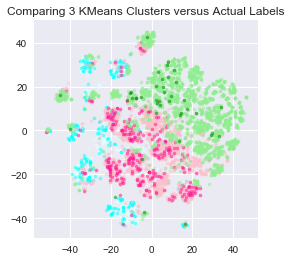

In [206]:
km_raw = KMeans(n_clusters=3, random_state=0).fit(X_scale)
km_raw.labels_
#Visualize the clusters versus the actual class labels
# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],km_raw.labels_):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(X_scale)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['lightcyan','cyan','pink','deeppink','lightgreen','g']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("Comparing 3 KMeans Clusters versus Actual Labels")
#plt.legend()

In [130]:
#Guassian Mixture on Raw Data
from sklearn.mixture import GaussianMixture

gaus_raw = GaussianMixture(n_components=2, random_state=0).fit_predict(X_scale)
gaus_raw

array([1, 1, 1, ..., 0, 1, 1], dtype=int64)

Automatically created module for IPython interactive environment


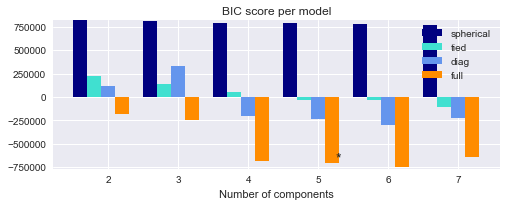

In [131]:
import numpy as np
import itertools

from scipy import linalg
import matplotlib.pyplot as plt
import matplotlib as mpl

from sklearn import mixture

print(__doc__)

lowest_bic = np.infty
bic = []
n_components_range = range(2, 8)
cv_types = ['spherical', 'tied', 'diag', 'full']
for cv_type in cv_types:
    for n_components in n_components_range:
        # Fit a Gaussian mixture with EM
        gmm = mixture.GaussianMixture(n_components=n_components,
                                      covariance_type=cv_type, random_state=0)
        gmm.fit(X_scale)
        bic.append(gmm.bic(X_scale))
        if bic[-1] < lowest_bic:
            lowest_bic = bic[-1]
            best_gmm = gmm

bic = np.array(bic)
color_iter = itertools.cycle(['navy', 'turquoise', 'cornflowerblue',
                              'darkorange'])
clf = best_gmm
bars = []

# Plot the BIC scores
plt.figure(figsize=(8, 6))
spl = plt.subplot(2, 1, 1)
for i, (cv_type, color) in enumerate(zip(cv_types, color_iter)):
    xpos = np.array(n_components_range) + .2 * (i - 2)
    bars.append(plt.bar(xpos, bic[i * len(n_components_range):
                                  (i + 1) * len(n_components_range)],
                        width=.2, color=color))
plt.xticks(n_components_range)
plt.ylim([bic.min() * 1.01 - .01 * bic.max(), bic.max()])
plt.title('BIC score per model')
xpos = np.mod(bic.argmin(), len(n_components_range)) + .65 +\
    .2 * np.floor(bic.argmin() / len(n_components_range))
plt.text(xpos, bic.min() * 0.97 + .03 * bic.max(), '*', fontsize=14)
spl.set_xlabel('Number of components')
spl.legend([b[0] for b in bars], cv_types)
plt.show()

Counter({6: 1960, 8: 1187, 2: 871, 10: 654, 4: 383, 7: 292, 11: 178, 0: 169, 5: 45, 9: 30, 3: 25, 1: 8})
0.04519774011299435
177
0.027901785714285716
896
0.10514018691588785
428
0.12966252220248667
2252
0.024650780608052588
1217
0.21394230769230768
832
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]


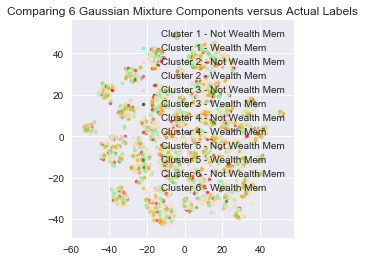

In [151]:
gaus_raw = GaussianMixture(n_components=6, random_state=0, covariance_type='full').fit_predict(X_scale)
gaus_raw

newlabels = []
for x, y in zip(df.iloc[:,0],list(gaus_raw)):
    if x == 0 and y == 0:
        newlabels.append(0)
    elif x == 1 and y == 0:
        newlabels.append(1)    
    elif x == 0 and y == 1:
        newlabels.append(2)
    elif x == 1 and y == 1:
        newlabels.append(3)
    elif x == 0 and y == 2:
        newlabels.append(4)
    elif x == 1 and y == 2:
        newlabels.append(5)
    elif x == 0 and y == 3:
        newlabels.append(6)
    elif x == 1 and y == 3:
        newlabels.append(7)
    elif x == 0 and y == 4:
        newlabels.append(8)
    elif x == 1 and y == 4:
        newlabels.append(9)
    elif x == 0 and y == 5:
        newlabels.append(10)
    elif x == 1 and y == 5:
        newlabels.append(11)
from collections import Counter
print(Counter(newlabels)) 
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[0] + Counter(newlabels)[1])
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[2] + Counter(newlabels)[3])
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))
print(Counter(newlabels)[4] + Counter(newlabels)[5])
print(Counter(newlabels)[7]/(Counter(newlabels)[6] + Counter(newlabels)[7]))
print(Counter(newlabels)[6] + Counter(newlabels)[7])
print(Counter(newlabels)[9]/(Counter(newlabels)[8] + Counter(newlabels)[9]))
print(Counter(newlabels)[8] + Counter(newlabels)[9])
print(Counter(newlabels)[11]/(Counter(newlabels)[10] + Counter(newlabels)[11]))
print(Counter(newlabels)[10] + Counter(newlabels)[11])   
labels=['Cluster 1 - Not Wealth Mem','Cluster 1 - Wealth Mem','Cluster 2 - Not Wealth Mem','Cluster 2 - Wealth Mem','Cluster 3 - Not Wealth Mem','Cluster 3 - Wealth Mem','Cluster 4 - Not Wealth Mem','Cluster 4 - Wealth Mem','Cluster 5 - Not Wealth Mem','Cluster 5 - Wealth Mem','Cluster 6 - Not Wealth Mem','Cluster 6 - Wealth Mem']
colours=['lightcyan','cyan','pink','deeppink','lightgray','black','mistyrose','red','lightgreen','g','bisque','orange']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(0,12):#, u in enumerate(unique):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.6, s=10)
plt.title("Comparing 6 Gaussian Mixture Components versus Actual Labels")
plt.legend()

**Phase 4 - Dimensionality Reduction**

---

In [133]:
#Perform PCA on the NHL Data
from sklearn.decomposition import PCA
pca = PCA(n_components=52)
pca_x = pca.fit(X_scale)
print(pca_x.explained_variance_ratio_)

[1.23413881e-01 5.86453875e-02 5.40469891e-02 4.89976657e-02
 4.03860390e-02 3.51743187e-02 3.20534730e-02 2.86795514e-02
 2.72624743e-02 2.60369652e-02 2.50270514e-02 2.29978467e-02
 2.24910554e-02 2.23846361e-02 2.20662002e-02 2.18323667e-02
 2.13444396e-02 2.11399037e-02 2.05217258e-02 2.03891317e-02
 2.01619244e-02 1.98216914e-02 1.96929607e-02 1.92792325e-02
 1.89228500e-02 1.88752176e-02 1.84965707e-02 1.72507342e-02
 1.62601315e-02 1.51309698e-02 1.46451782e-02 1.40510513e-02
 1.28052371e-02 1.16193274e-02 1.07342365e-02 9.34847022e-03
 8.37617058e-03 7.83209827e-03 7.16198963e-03 6.31433072e-03
 5.40553116e-03 4.10648165e-03 3.30101741e-03 3.04273733e-03
 2.47275714e-03 2.43390965e-32 2.96594537e-33 2.65784082e-33
 6.63568890e-34 6.31247712e-34 5.56361293e-34 2.49522991e-34]


Text(0,0.5,'Cumulative Variance Explained')

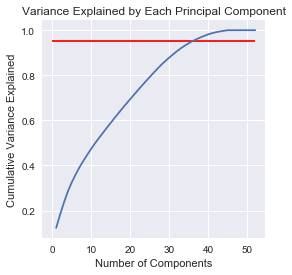

In [136]:
sum_ = []
sum_no = 0.0
for x in pca_x.explained_variance_ratio_:
    sum_no += x
    sum_.append(sum_no)
sum_

# plot the variance explained by each new component
plt.figure( figsize=(4,4) )
plt.plot(range(1,53,1), sum_)
plt.hlines(0.95, 0, 52, colors='red')
plt.title('Variance Explained by Each Principal Component')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Variance Explained')

Text(0,0.5,'Eigenvalues')

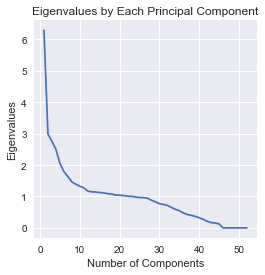

In [138]:
pca_x.explained_variance_

# plot the eigenvalues of each component
plt.figure( figsize=(4,4) )
plt.plot(range(1,53,1), pca_x.explained_variance_)
plt.title('Eigenvalues by Each Principal Component')
plt.xlabel('Number of Components')
plt.ylabel('Eigenvalues')

In [140]:
#Perform PCA on the Wealth Data
from sklearn.decomposition import PCA
pca = PCA(n_components=27)
pca_x = pca.fit_transform(X_scale)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.012s...
[t-SNE] Computed neighbors for 5802 samples in 2.720s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 1.960855
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.641075
[t-SNE] KL divergence after 500 iterations: 1.337766


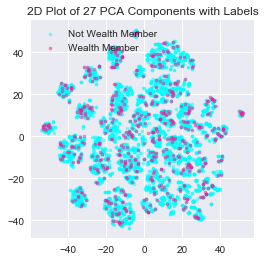

In [150]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(pca_x)

# Create the scatter
labels=['Not Wealth Member','Wealth Member']
colours=['aqua','deeppink']
unique = list(set(df.iloc[:,0]))
plt.figure( figsize=(4,4) )
for i in range(2):#, u in enumerate(unique):
    xi = [list(tsne_results[:,0])[j] for j in range(len(tsne_results)) if y[j] == i]
    yi = [list(tsne_results[:,1])[j] for j in range(len(tsne_results)) if y[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 27 PCA Components with Labels")
plt.legend()

In [153]:
#Perform ICA on the NHL Data
from sklearn.decomposition import FastICA
ica = FastICA(n_components=52, max_iter=10000, random_state=0)
ica_p = ica.fit(X_scale)
ica_x = ica.fit_transform(X_scale)
#print(ica_x.components_)

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\decomposition\fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\decomposition\fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


In [154]:
from scipy.stats import kurtosis
kurt = []
for x in ica_p.components_:
    kurt.append(kurtosis(x))
kurt

[2.3569635359790784,
 22.277228988130332,
 19.964965220051575,
 3.898216167472346,
 15.016924313123415,
 20.105920762490157,
 26.933298778020035,
 30.697916317668394,
 9.814078923720404,
 3.375292267139649,
 3.336250243314213,
 1.787218997312305,
 33.73528112761951,
 1.144696622218146,
 4.272312940308371,
 3.7026609529211063,
 24.022993603203805,
 19.470816822380694,
 26.069566295060405,
 12.693333053026766,
 6.644410590120236,
 30.79791494461989,
 1.2067114768427656,
 2.62039199840103,
 9.416485083684737,
 1.933354033262236,
 24.555741635239123,
 9.892481946079165,
 23.100836124079848,
 5.742591921583237,
 10.993761045323703,
 24.420264039509057,
 8.310570407272662,
 4.152564866966271,
 4.978259769324639,
 29.951617988225863,
 3.02533659384268,
 1.1183555238308793,
 7.230064787995776,
 11.533924859448264,
 26.771183620243832,
 0.9134837511554363,
 4.999404097325682,
 12.495052137262354,
 21.588110064445043,
 13.936070373693497,
 5.713568111683829,
 0.7595163419883924,
 4.2695547651055

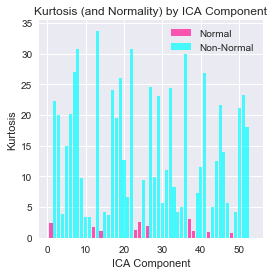

In [161]:
plt.figure( figsize=(4,4))
for i in range(53):
    if kurt[i] < 3.3:
        plt.bar(i+1, kurt[i], align='center', alpha=0.7, color="deeppink", label = "Normal")
    else:
        plt.bar(i+1, kurt[i], align='center', alpha=0.7, color="cyan", label = "Non-Normal")
        
#plt.bar(range(2,24), silscores, align='center', alpha=0.7, color="cyan")
#plt.xticks(range(2,21), silscores)
plt.title('Kurtosis (and Normality) by ICA Component')
plt.xlabel('ICA Component')
plt.ylabel('Kurtosis')
plt.legend(['Normal','Non-Normal'])
plt.show()

In [157]:
from scipy.stats import normaltest

alpha = 0.0001

newarray = []
for x in ica_p.components_:
    k2, p = normaltest(x)
    kurt.append(p)
    if p < alpha: 
        print("Not normal")
        newarray.append(x)
    else:
        print("Normal")
good_ica = np.array(newarray)
good_ica

Normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Normal
Not normal
Normal
Not normal
Normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Normal
Normal
Not normal
Normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Not normal
Normal
Not normal
Not normal
Not normal
Normal
Not normal
Not normal
Not normal
Not normal
Not normal
Normal
Not normal
Not normal
Not normal
Not normal


array([[-2.82980873e-04, -5.63845012e-04,  8.87153471e-04, ...,
         1.54509957e+12,  1.79441581e+12,  2.45543080e+12],
       [ 2.78567588e-03, -1.00132309e-02,  2.62381432e-04, ...,
         1.40461636e+12,  1.63126432e+12,  2.23217866e+12],
       [ 8.04956352e-03, -5.24661591e-03,  6.69885815e-03, ...,
         1.08049421e+12,  1.25484203e+12,  1.71709242e+12],
       ...,
       [ 3.02268652e-03, -5.11063001e-03, -5.28680962e-03, ...,
        -4.30489740e+10, -4.99953279e+10, -6.84122753e+10],
       [-1.61758370e-03, -1.24033900e-03,  2.93941953e-03, ...,
         9.31872683e+11,  1.08223904e+12,  1.48090708e+12],
       [-4.23000035e-03,  4.12410933e-03, -9.78519660e-04, ...,
        -2.52817546e+12, -2.93612017e+12, -4.01770865e+12]])

In [162]:
#trans_ica = good_ica.dot(X_scale.T)
#trans_ica.T.shape

trans_ica = X_scale.dot(good_ica.T)
trans_ica.shape

(5802, 42)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.015s...
[t-SNE] Computed neighbors for 5802 samples in 4.001s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 0.035511
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.303978
[t-SNE] KL divergence after 500 iterations: 1.978485
15507    0
39443    0
2758     0
28343    0
56454    0
Name: HasCAM_CSI, dtype: object


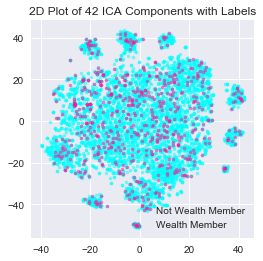

In [165]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(trans_ica)

df_tsne = df.iloc[:,0].copy()
df_tsne['x-tsne'] = tsne_results[:,0]
df_tsne['y-tsne'] = tsne_results[:,1]
print(df_tsne.head())

# Create the scatter
labels=['Not Wealth Member','Wealth Member']
colours=['aqua','deeppink']
unique = list(set(df.iloc[:,0]))
plt.figure( figsize=(4,4) )
for i, u in enumerate(unique):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if y[j] == u]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if y[j] == u]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 42 ICA Components with Labels")
plt.legend()

In [166]:
import scipy.sparse as sps
from numpy.linalg import pinv

def reconstructionError(projections,X):
    W = projections.components_
    if sps.issparse(W):
        W = W.todense()
    p = pinv(W)
    reconstructed = ((p@W)@(X.T)).T # Unproject projected data
    errors = np.square(X-reconstructed)
    return np.nanmean(errors)

In [167]:
#reduce dimensions with Random Projections
from sklearn.random_projection import SparseRandomProjection
transformer = SparseRandomProjection(n_components=52, random_state=0)
X_new = transformer.fit(X_scale)
X_new.components_

<52x52 sparse matrix of type '<class 'numpy.float64'>'
	with 365 stored elements in Compressed Sparse Row format>

In [179]:
from sklearn.random_projection import johnson_lindenstrauss_min_dim
johnson_lindenstrauss_min_dim(n_samples=X_scale.shape[0], eps=0.2)

1999

In [169]:
best15 = 1.0
besta = 0
ind_ = 0
ran = []
for a in range(10000):
    err = []
    for i in range(24, 28):
        transformer = SparseRandomProjection(n_components=i, random_state=a)
        X_new = transformer.fit(X_scale)
        errors = reconstructionError(X_new, X_scale)
        err.append(errors)
    ind = err.index(min(err))
    ran.append(err[ind])
    if err[ind] < best15:
        best15 = err[ind]
        ind_= ind + 24
        besta = a
print(best15)
print(ind_)
print(besta)
print(ran)

0.4212980241472023
27
7682
[0.4692554678157502, 0.4825601472251908, 0.4908584206256542, 0.4611408279718483, 0.4491614496570667, 0.46184721633736364, 0.44245575148042426, 0.47837540329325284, 0.49145286945605016, 0.47587496139492397, 0.47658049316472484, 0.4545432508537102, 0.46156294830635347, 0.4480601738812633, 0.460324420404937, 0.48197535711230943, 0.46353034579075436, 0.4661379113801237, 0.46605320058431354, 0.47645997289751457, 0.48247917572346, 0.4634313476732336, 0.48541590337790974, 0.4485662182506453, 0.4889846940342685, 0.4717789616581773, 0.4798157443121569, 0.46718611145819133, 0.47064764532996967, 0.47334942710553685, 0.4626963851634017, 0.45176759227940627, 0.48200869878999575, 0.46645157179727564, 0.47269424534975246, 0.478289036471245, 0.46920372167101093, 0.47827745688997864, 0.4696573617412825, 0.4503780180949001, 0.46951692332661643, 0.4538717498580836, 0.46307712826035363, 0.45948101488926807, 0.47788298552148223, 0.4507830284508607, 0.4547808041028655, 0.469280541

Text(0,0.5,'Reconstruction Error')

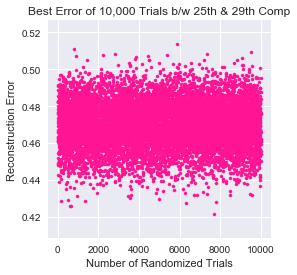

In [172]:
# plot the reconstruction error of each random trial
plt.figure( figsize=(4,4) )
plt.scatter(range(1,10001,1), ran, c='deeppink', s=10)
plt.title('Best Error of 10,000 Trials b/w 25th & 29th Comp')
plt.xlabel('Number of Randomized Trials')
plt.ylabel('Reconstruction Error')

In [173]:
err = []
for i in range(1, 53):
    transformer = SparseRandomProjection(n_components=i, random_state=7682)
    X_new = transformer.fit(X_scale)
    errors = reconstructionError(X_new, X_scale)
    err.append(errors)
err

[0.9582456411205011,
 0.9438063969100596,
 0.9219195461122105,
 0.9010715854606841,
 0.8786859068549275,
 0.8746054071221953,
 0.8391678382057366,
 0.8261549071170611,
 0.8108439635733982,
 0.7970659841182561,
 0.7784105048938523,
 0.7242208694387883,
 0.7511842174140079,
 0.702484146958876,
 0.6823883060200676,
 0.6660675548154475,
 0.6597962464906039,
 0.6343267463065968,
 0.59100102434118,
 0.6194625507068368,
 0.5735874649043629,
 0.5758928277612219,
 0.5370818577445917,
 0.5473536566664344,
 0.5154204471777066,
 0.48667974895168276,
 0.4212980241472023,
 0.42148123550158767,
 0.44623035876308625,
 0.388355651127705,
 0.4068502119835212,
 0.3769901833809676,
 0.3606120542072304,
 0.31948947523832677,
 0.3110455769015127,
 0.29448356224189903,
 0.2887061856448882,
 0.2773654472307731,
 0.23688221281080382,
 0.2348556982468913,
 0.2049379105083043,
 0.18492705056233366,
 0.1513032329302259,
 0.15952050144917604,
 0.1269826787786878,
 0.10695542126742236,
 0.08672488824050884,
 0.0847

Text(0,0.5,'Reconstruction Error')

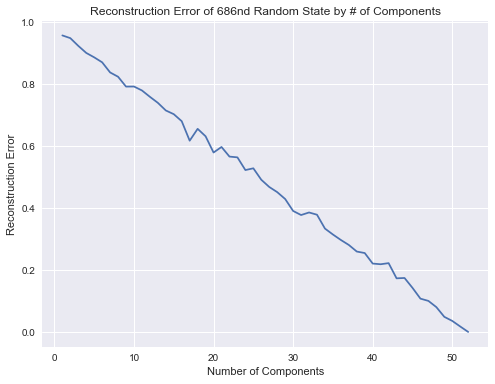

In [72]:
# plot the reconstruction error of the 801st random state
plt.plot(range(1,53,1), err)
plt.title('Reconstruction Error of 686nd Random State by # of Components')
plt.xlabel('Number of Components')
plt.ylabel('Reconstruction Error')

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.010s...
[t-SNE] Computed neighbors for 5802 samples in 2.487s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 2.077439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.102669
[t-SNE] KL divergence after 500 iterations: 1.668656
15507    0
39443    0
2758     0
28343    0
56454    0
Name: HasCAM_CSI, dtype: object


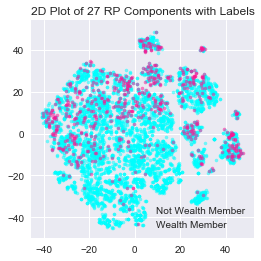

In [175]:
transformer = SparseRandomProjection(n_components=27, random_state=7682)
X_new = transformer.fit_transform(X_scale)


tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(X_new)

df_tsne = df.iloc[:,0].copy()
df_tsne['x-tsne'] = tsne_results[:,0]
df_tsne['y-tsne'] = tsne_results[:,1]
print(df_tsne.head())

# Create the scatter
labels=['Not Wealth Member','Wealth Member']
colours=['aqua','deeppink']
unique = list(set(df.iloc[:,0]))
plt.figure( figsize=(4,4) )
for i, u in enumerate(unique):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if y[j] == u]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if y[j] == u]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 27 RP Components with Labels")
plt.legend()

In [180]:
#feature selection using recursive feature elimination

from sklearn.feature_selection import RFECV
from sklearn.svm import LinearSVC
estimator = LinearSVC(random_state=0)
selector = RFECV(estimator, step=1, cv=5, scoring='f1',min_features_to_select=7)
selec = selector.fit(X_scale, y)
selector = selec.transform(X_scale)
selec

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\e4129\AppData\Local\Continuum\ana

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-package

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:9

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-package

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:9

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\e4129\AppData\Local\Continuum\ana

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-package

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:9

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:9

RFECV(cv=5,
   estimator=LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=0, tol=0.0001,
     verbose=0),
   min_features_to_select=7, n_jobs=None, scoring='f1', step=1, verbose=0)

In [181]:
selector.shape

(5802, 15)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.020s...
[t-SNE] Computed neighbors for 5802 samples in 1.322s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 0.556683
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.005898
[t-SNE] KL divergence after 500 iterations: 0.949149


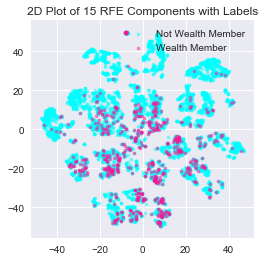

In [183]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(selector)

# Create the scatter
labels=['Not Wealth Member','Wealth Member']
colours=['aqua','deeppink']
unique = list(set(df.iloc[:,0]))
plt.figure( figsize=(4,4) )
for i, u in enumerate(unique):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if y[j] == u]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if y[j] == u]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 15 RFE Components with Labels")
plt.legend()

**Phase 4 - Applying Clustering to Reduced Dimensions **

---


Text(0.5,1,'Elbow curve')

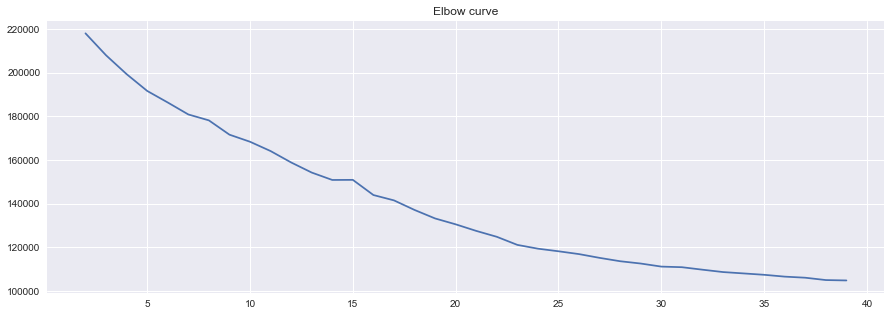

In [184]:
distorsions = []
for k in range(2, 40):
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(pca_x)
    distorsions.append(kmeans.inertia_)

fig = plt.figure(figsize=(15, 5))
plt.plot(range(2, 40), distorsions)
#plt.grid(True)
plt.title('Elbow curve')


Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.1117796492039539
For n_clusters = 3 The average silhouette_score is : 0.11569657480493929
For n_clusters = 4 The average silhouette_score is : 0.07876385892916125
For n_clusters = 5 The average silhouette_score is : 0.08161208297307294
For n_clusters = 6 The average silhouette_score is : 0.0831188992254867
For n_clusters = 7 The average silhouette_score is : 0.07409888757879472
For n_clusters = 8 The average silhouette_score is : 0.09308702165356082
For n_clusters = 9 The average silhouette_score is : 0.06562901529002381
For n_clusters = 10 The average silhouette_score is : 0.07701135287232888
For n_clusters = 11 The average silhouette_score is : 0.0922436520370112
For n_clusters = 12 The average silhouette_score is : 0.0988213250570685
For n_clusters = 13 The average silhouette_score is : 0.08538236244289017
For n_clusters = 14 The average silhouette_score is : 0.108

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


For n_clusters = 22 The average silhouette_score is : 0.11278904837833373


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


For n_clusters = 23 The average silhouette_score is : 0.10993016558420489


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


For n_clusters = 24 The average silhouette_score is : 0.10535004224833937


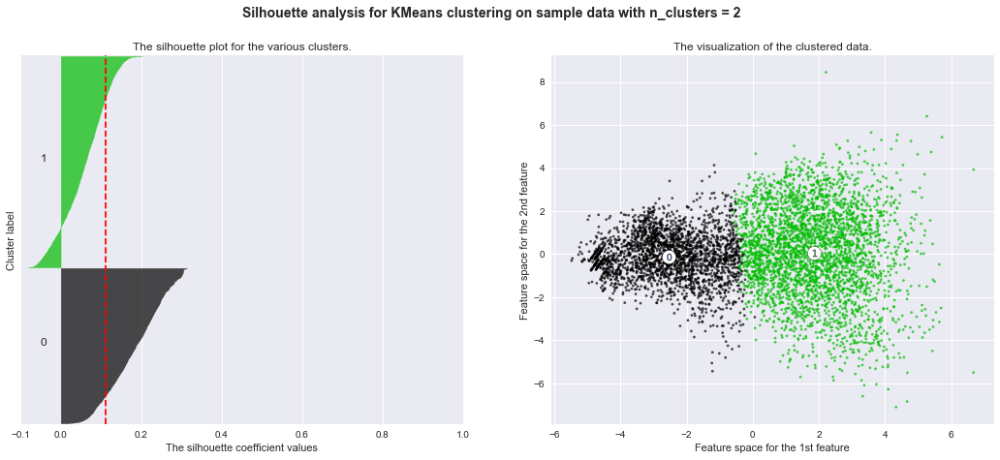

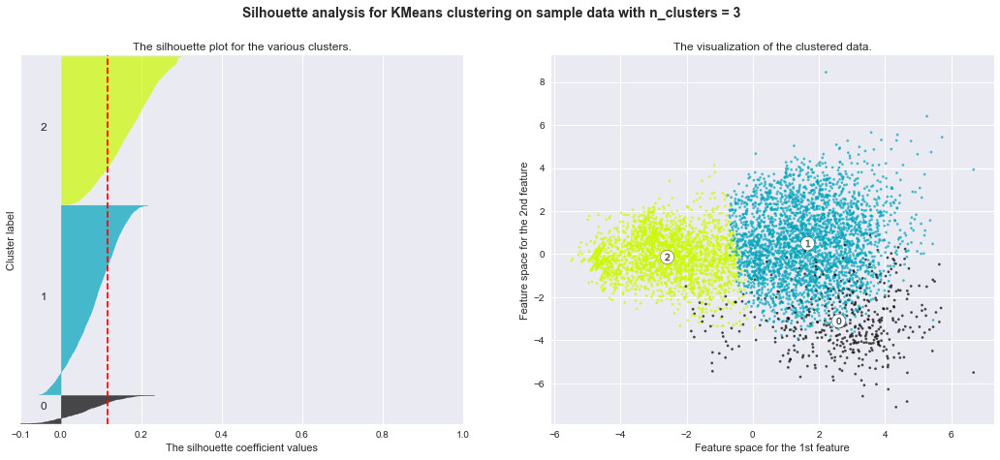

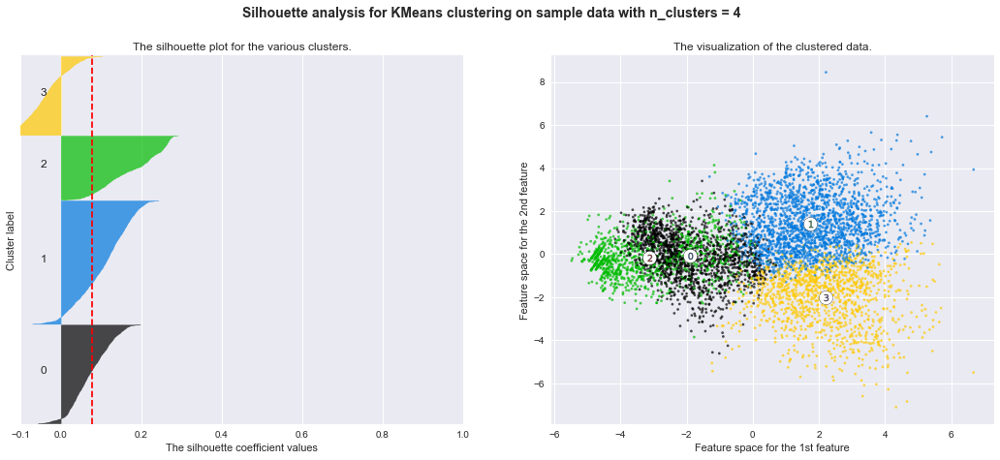

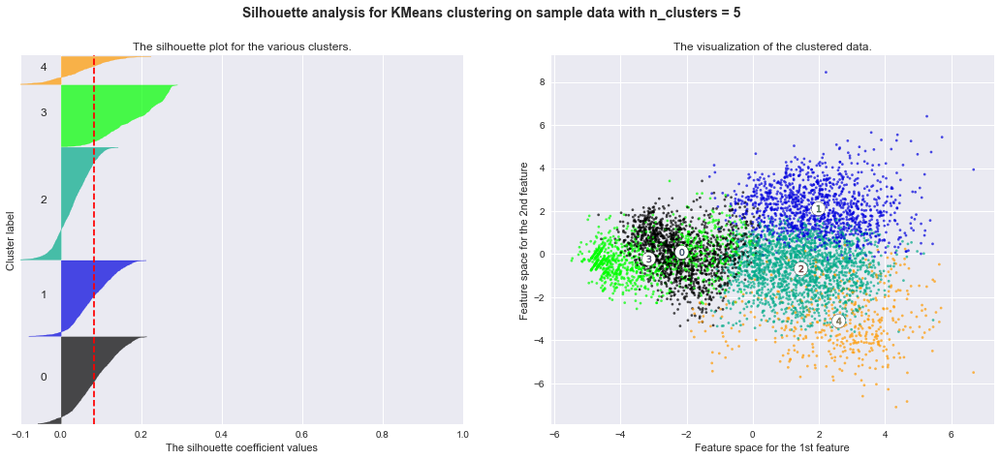

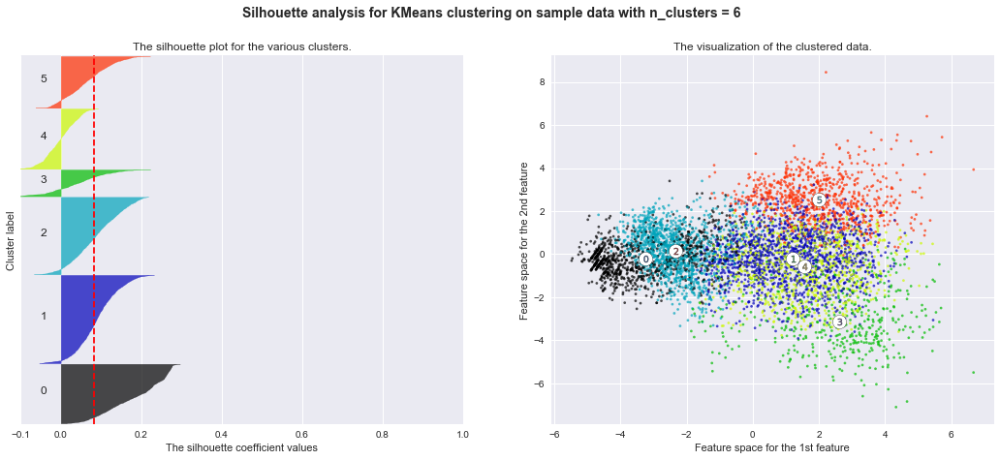

...

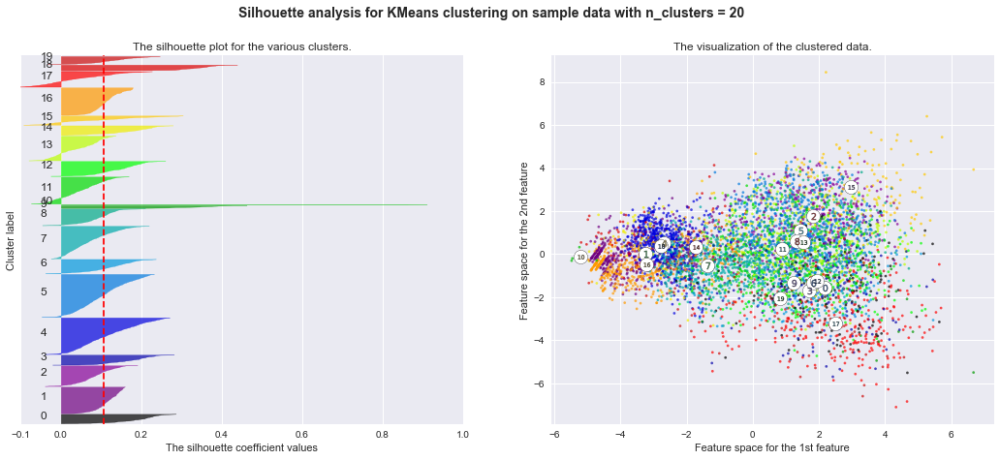

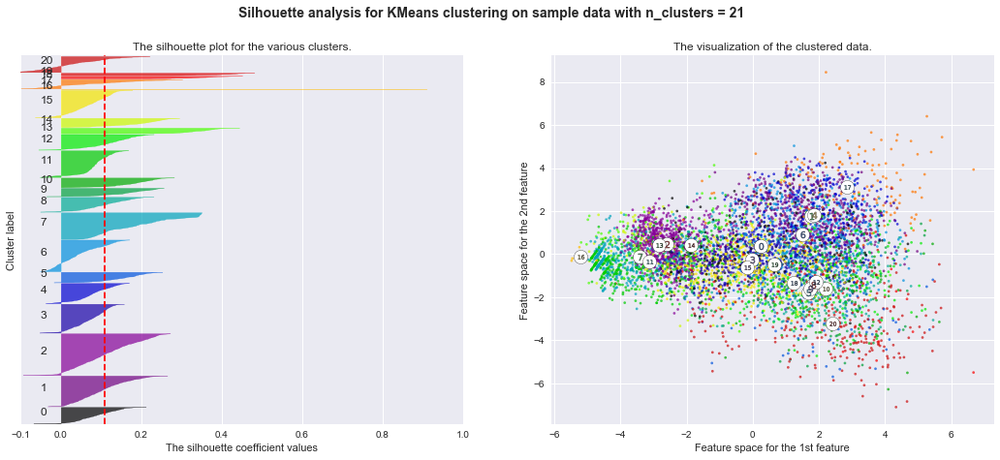

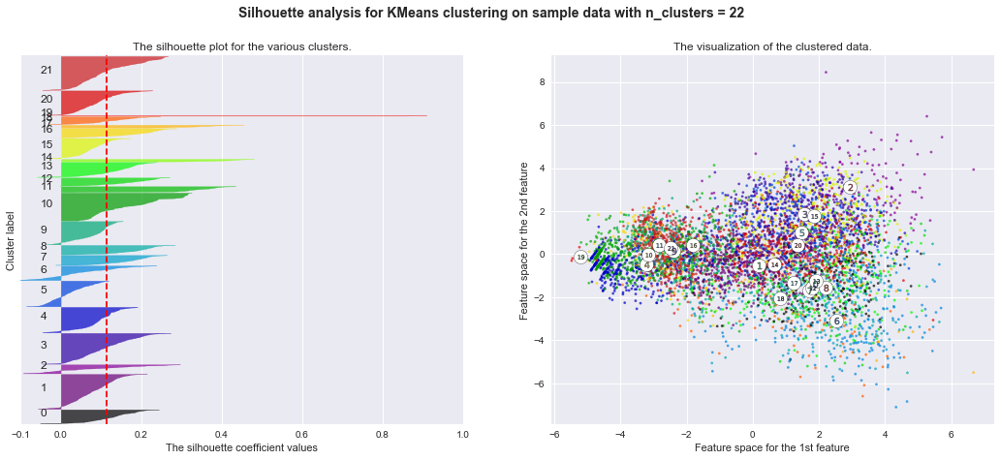

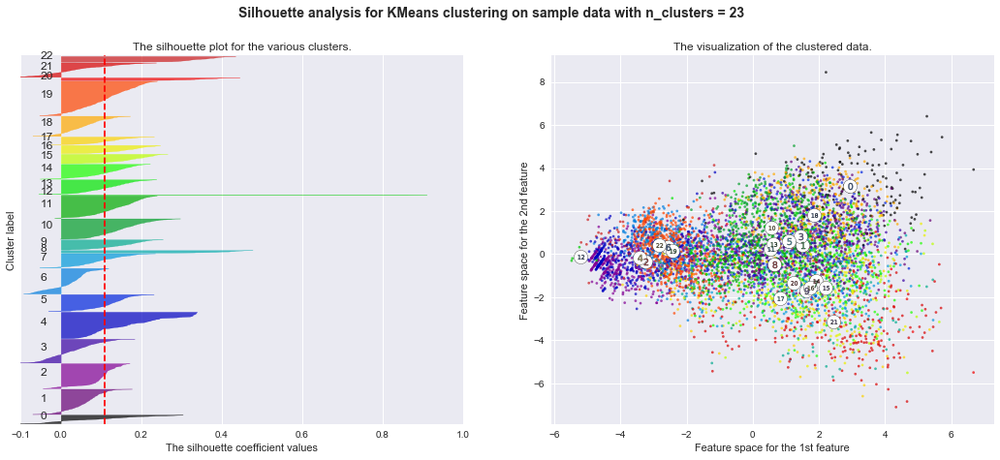

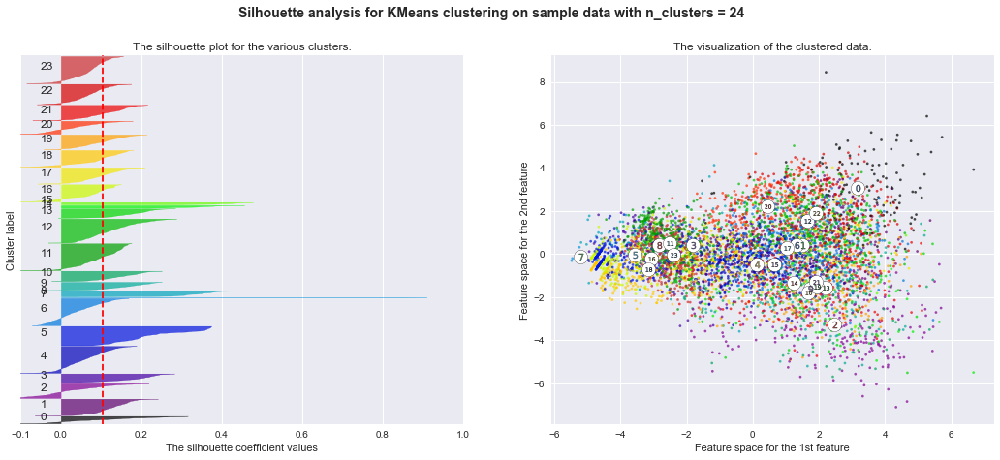

In [185]:
from __future__ import print_function

from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = range(2,25)

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(pca_x)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(pca_x, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(pca_x, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(pca_x[:, 0], pca_x[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Counter({2: 2663, 4: 2119, 0: 407, 3: 342, 5: 230, 1: 41})
0.09151785714285714
0.11381031613976705
0.09791400595998297
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.010s...
[t-SNE] Computed neighbors for 5802 samples in 3.198s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 1.960855
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.643326
[t-SNE] KL divergence after 500 iterations: 1.337839
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 KMeans Clusters on PCA')

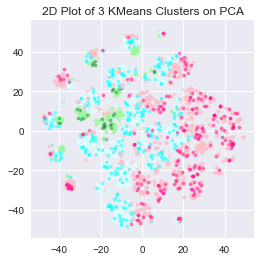

In [192]:
#Visualize the clusters versus the actual class labels
#perform the kmeans on reduced data
km_pca = KMeans(n_clusters=3, random_state=0).fit(pca_x)
km_pca.labels_

# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],km_pca.labels_):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(pca_x)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 KMeans Clusters on PCA")
#plt.legend()

Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.1244043206852303
For n_clusters = 3 The average silhouette_score is : 0.13040830382347454
For n_clusters = 4 The average silhouette_score is : 0.05309317975390254
For n_clusters = 5 The average silhouette_score is : 0.07300401942831852
For n_clusters = 6 The average silhouette_score is : 0.042696781406004386
For n_clusters = 7 The average silhouette_score is : 0.03317973982510549
For n_clusters = 8 The average silhouette_score is : 0.06187093821174849
For n_clusters = 9 The average silhouette_score is : 0.05904972013976234
For n_clusters = 10 The average silhouette_score is : 0.05136900970618687
For n_clusters = 11 The average silhouette_score is : 0.035435771299493456
For n_clusters = 12 The average silhouette_score is : 0.03630079485046823
For n_clusters = 13 The average silhouette_score is : 0.035128854124958454
For n_clusters = 14 The average silhouette_score is :

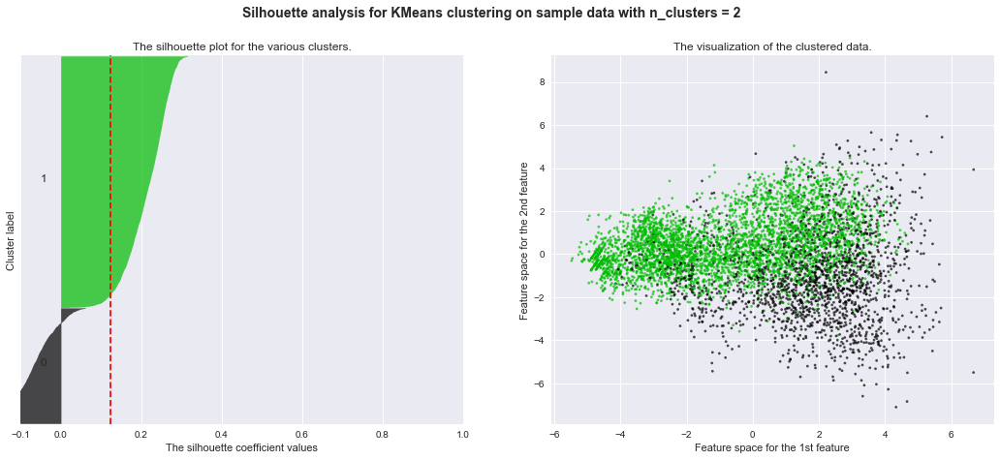

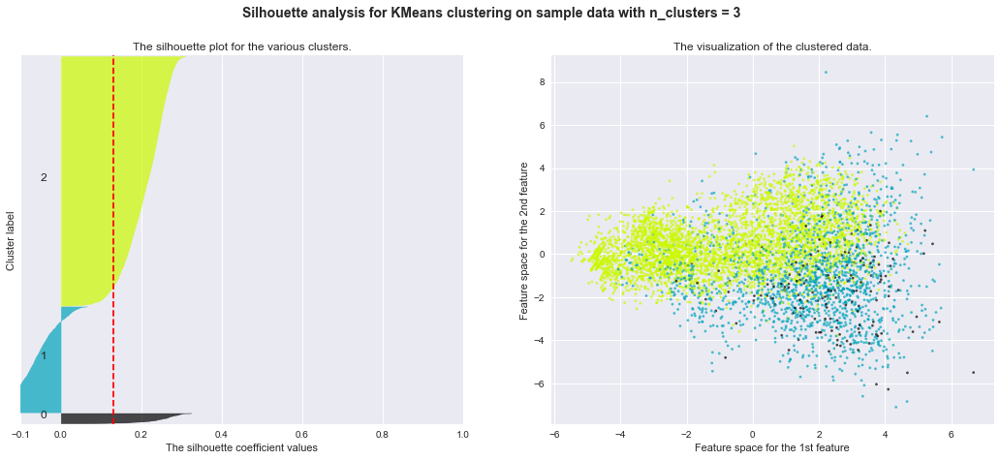

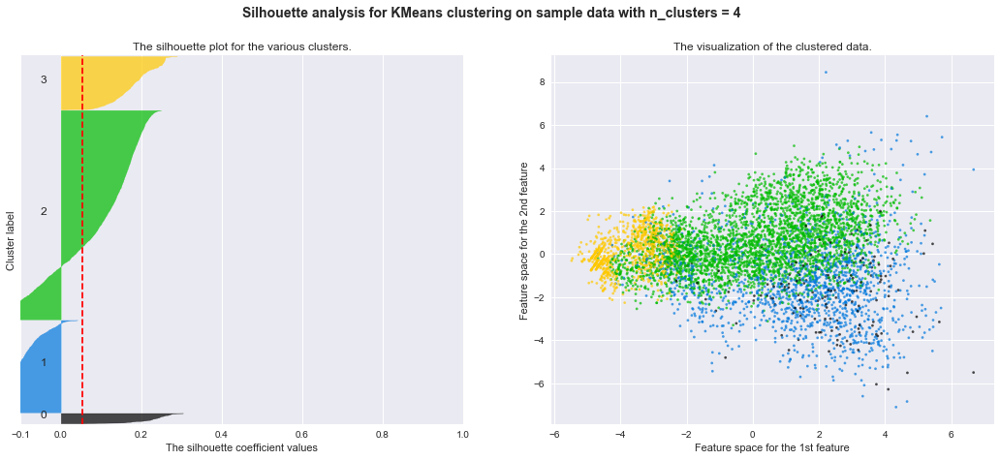

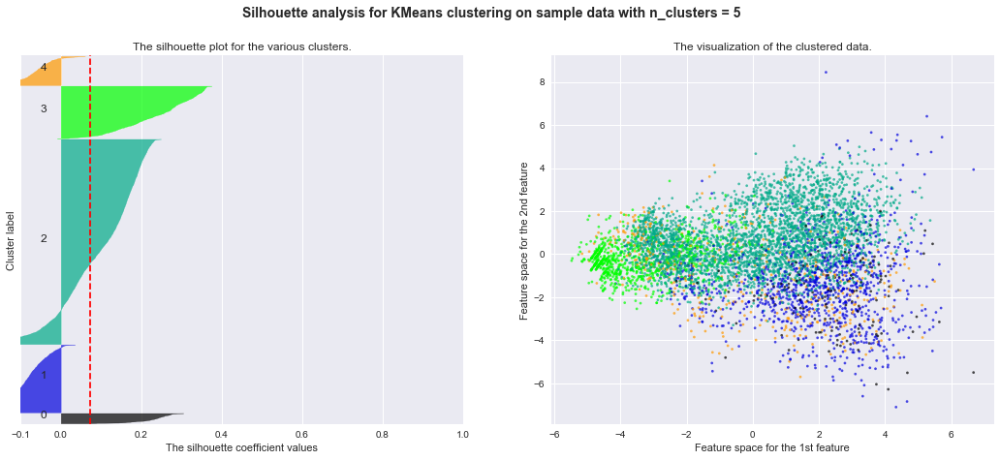

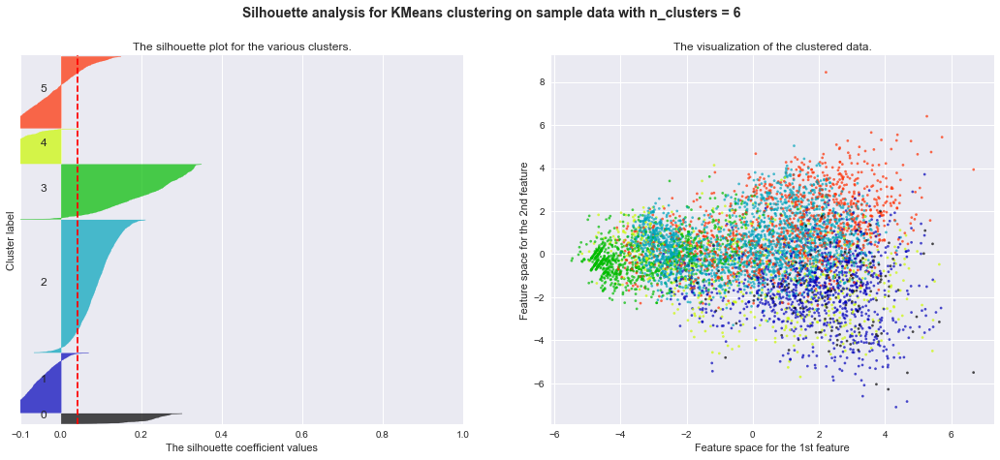

...

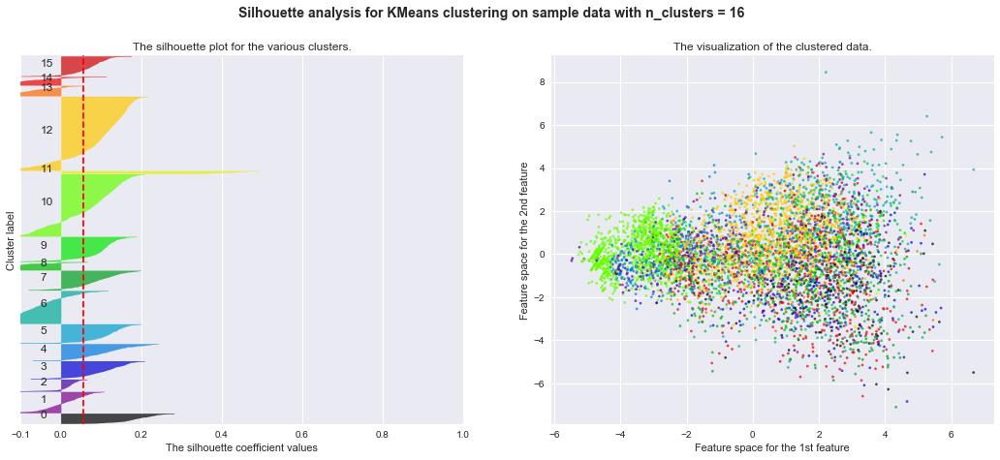

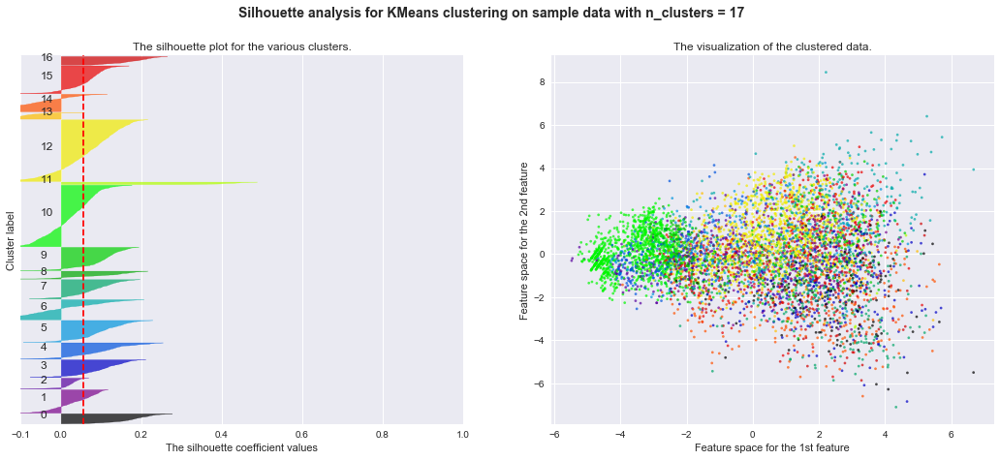

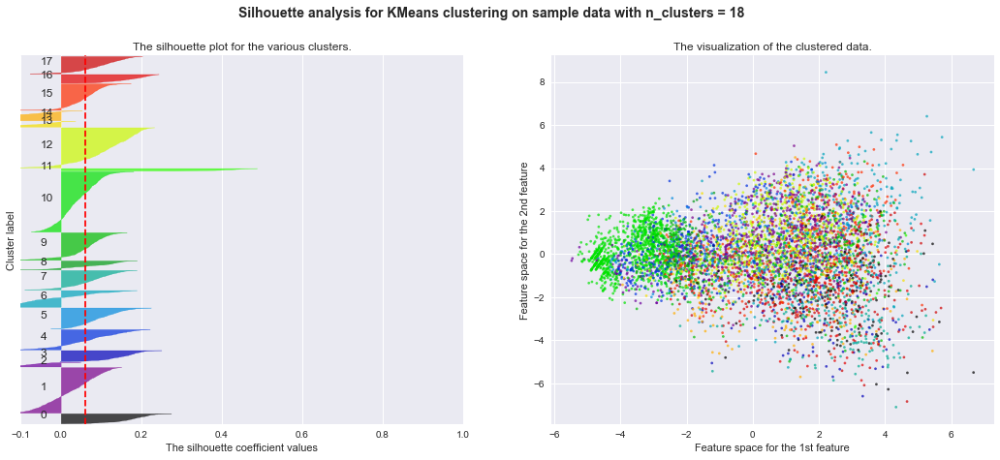

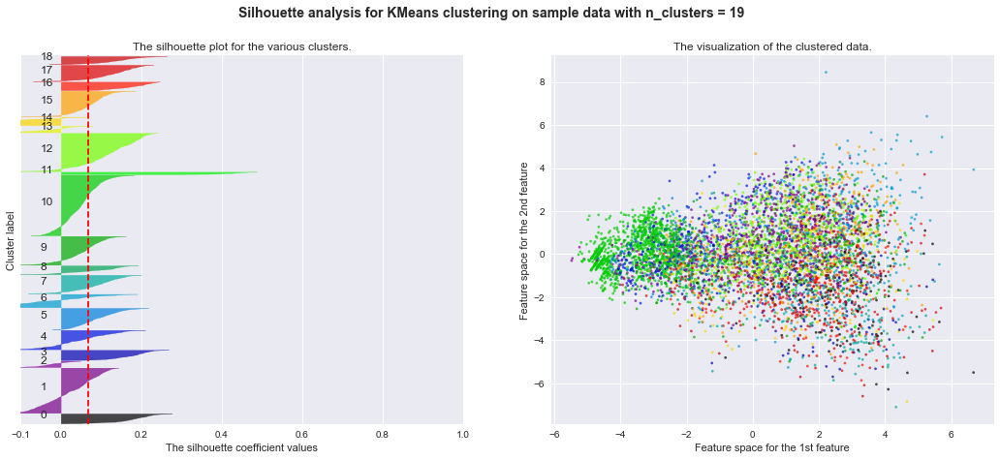

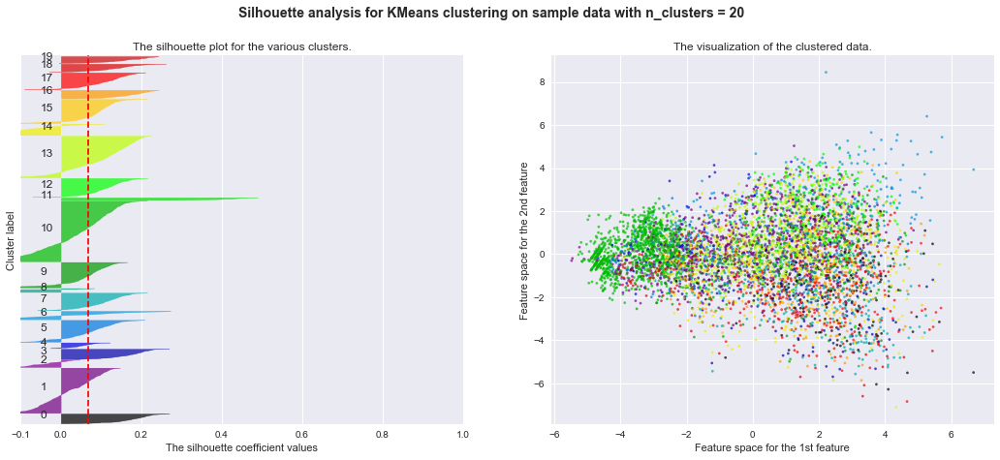

In [189]:
from __future__ import print_function

from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [2, 3, 4, 5, 6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    #gaus_pca = GaussianMixture(n_components=2, random_state=0).fit_predict(pca_x)
    clusterer = GaussianMixture(n_components=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(pca_x)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(pca_x, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(pca_x, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(pca_x[:, 0], pca_x[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    '''# Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')'''

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Counter({4: 3540, 2: 1508, 5: 418, 3: 172, 0: 141, 1: 23})
0.1402439024390244
0.10238095238095238
0.1056088933804952
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.017s...
[t-SNE] Computed neighbors for 5802 samples in 2.604s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 1.960855
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.605667
[t-SNE] KL divergence after 500 iterations: 1.326631
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 Gaussian Mixtures on PCA')

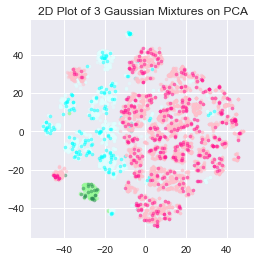

In [194]:
gaus_pca = GaussianMixture(n_components=3, random_state=0).fit_predict(pca_x)

# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],gaus_pca):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(pca_x)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 Gaussian Mixtures on PCA")
#plt.legend()

Counter({4: 2029, 0: 1903, 2: 1257, 5: 244, 1: 215, 3: 154})
0.10151085930122758
0.10914245216158752
0.1073471183457985
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.016s...
[t-SNE] Computed neighbors for 5802 samples in 3.976s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 0.035511
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.298927
[t-SNE] KL divergence after 500 iterations: 1.979464
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 KMeans Clusters on ICA')

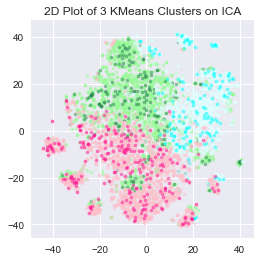

In [196]:
#Visualize the clusters versus the actual class labels
#perform the kmeans on reduced data
km_ica = KMeans(n_clusters=3, random_state=0).fit(trans_ica)
km_ica.labels_

# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],km_ica.labels_):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(trans_ica)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 KMeans Clusters on ICA")
#plt.legend()

Counter({0: 3189, 2: 1416, 4: 584, 1: 385, 3: 162, 5: 66})
0.10772243984331281
0.10266159695817491
0.10153846153846154
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.013s...
[t-SNE] Computed neighbors for 5802 samples in 3.977s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 0.035511
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.300629
[t-SNE] KL divergence after 500 iterations: 1.974495
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 Gaussian Mixtures on ICA')

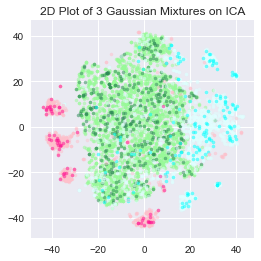

In [197]:
gaus_ica = GaussianMixture(n_components=3, random_state=0).fit_predict(trans_ica)

newlabels = []
# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],gaus_ica):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(trans_ica)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 Gaussian Mixtures on ICA")
#plt.legend()

Counter({2: 2246, 4: 1605, 0: 1338, 1: 292, 5: 274, 3: 47})
0.17914110429447852
0.020497165285651986
0.14582224587546566
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.012s...
[t-SNE] Computed neighbors for 5802 samples in 2.613s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 2.077439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.086121
[t-SNE] KL divergence after 500 iterations: 1.665127
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 KMeans Clusters on RP')

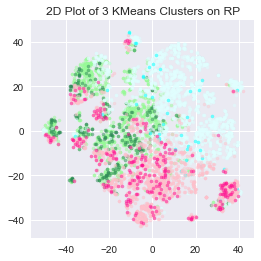

In [199]:
#Visualize the clusters versus the actual class labels
#perform the kmeans on reduced data
km_rp = KMeans(n_clusters=3, random_state=0).fit(X_new)
km_rp.labels_

# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],km_rp.labels_):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(X_new)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 KMeans Clusters on RP")
#plt.legend()

Counter({4: 3548, 0: 1101, 2: 540, 1: 268, 5: 252, 3: 93})
0.19576333089846604
0.14691943127962084
0.06631578947368422
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.014s...
[t-SNE] Computed neighbors for 5802 samples in 2.589s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 2.077439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.106873
[t-SNE] KL divergence after 500 iterations: 1.692312
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 Gaussian Mixtures on RP')

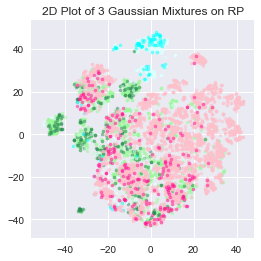

In [201]:
gaus_rp = GaussianMixture(n_components=3, random_state=0).fit_predict(X_new)

newlabels = []
for x, m in zip(df.iloc[:,0],gaus_rp):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(X_new)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 Gaussian Mixtures on RP")
#plt.legend()

Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.20995656148122446
For n_clusters = 3 The average silhouette_score is : 0.21681291157682836
For n_clusters = 4 The average silhouette_score is : 0.16700754046801544
For n_clusters = 5 The average silhouette_score is : 0.1607328609382066
For n_clusters = 6 The average silhouette_score is : 0.1677409882896718
For n_clusters = 7 The average silhouette_score is : 0.17745305005621573
For n_clusters = 8 The average silhouette_score is : 0.18139375575886926
For n_clusters = 9 The average silhouette_score is : 0.17501315218584826
For n_clusters = 10 The average silhouette_score is : 0.17694941128388791
For n_clusters = 11 The average silhouette_score is : 0.1740718993288386
For n_clusters = 12 The average silhouette_score is : 0.17673256945177127
For n_clusters = 13 The average silhouette_score is : 0.17333421125321122
For n_clusters = 14 The average silhouette_score is : 0.17

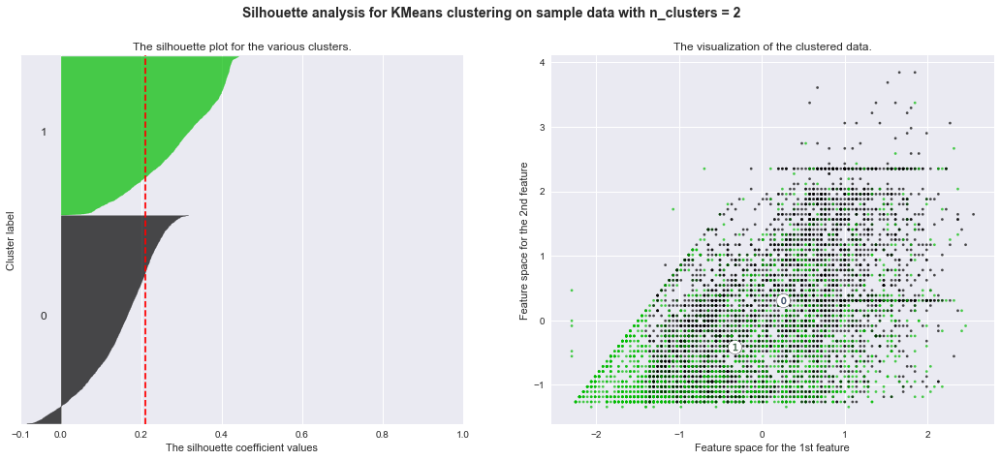

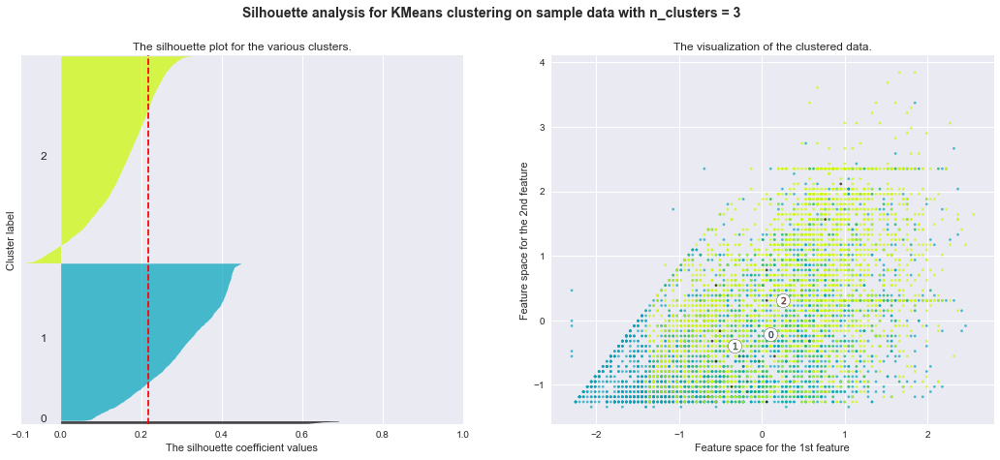

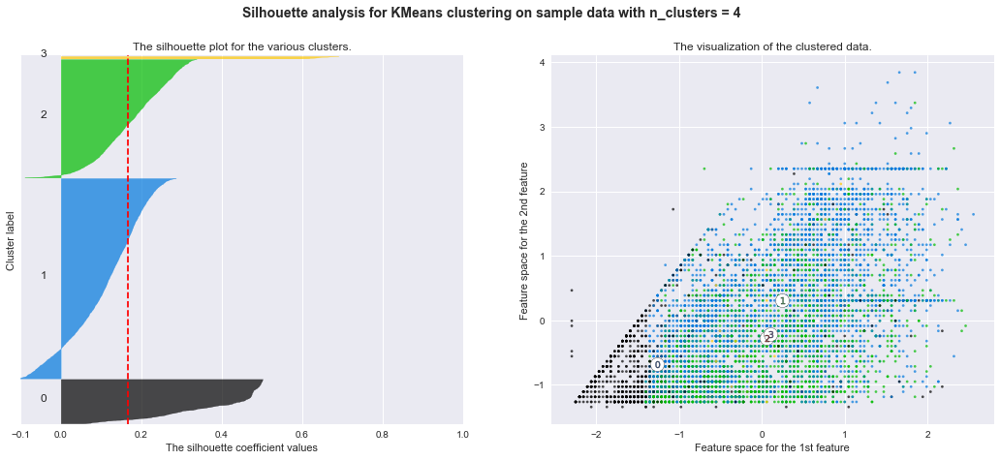

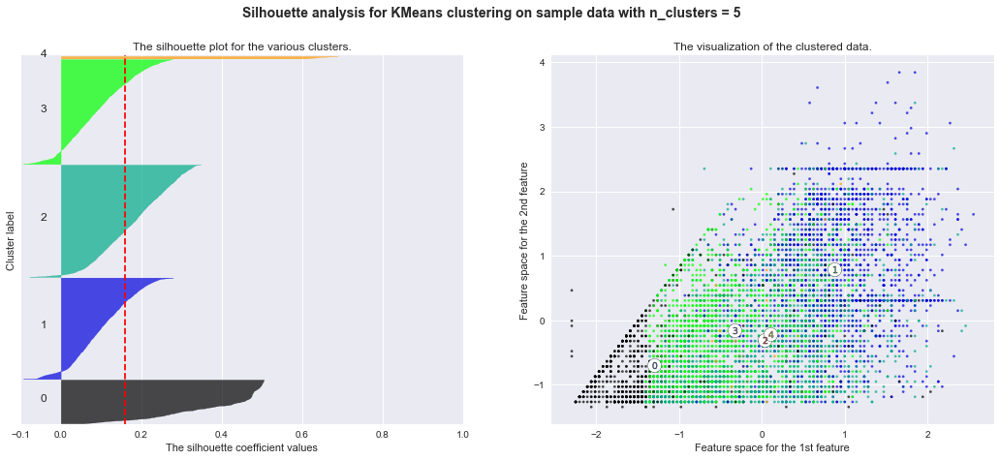

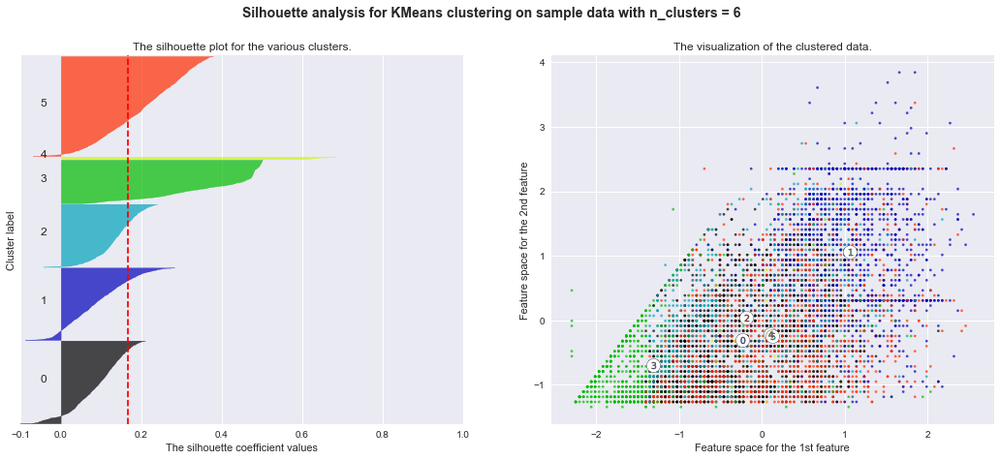

...

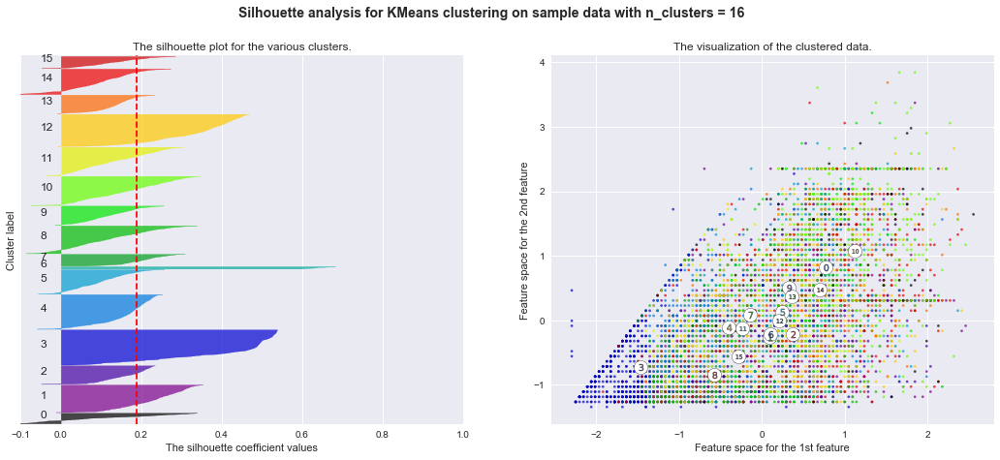

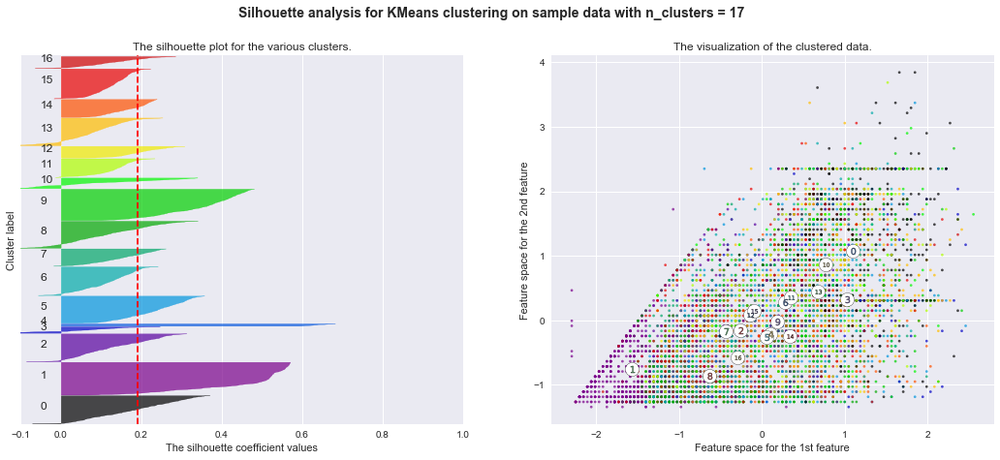

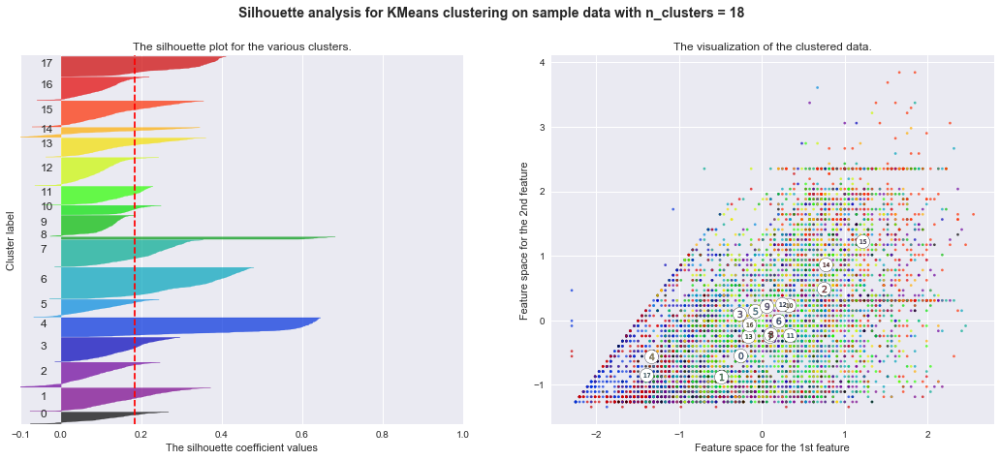

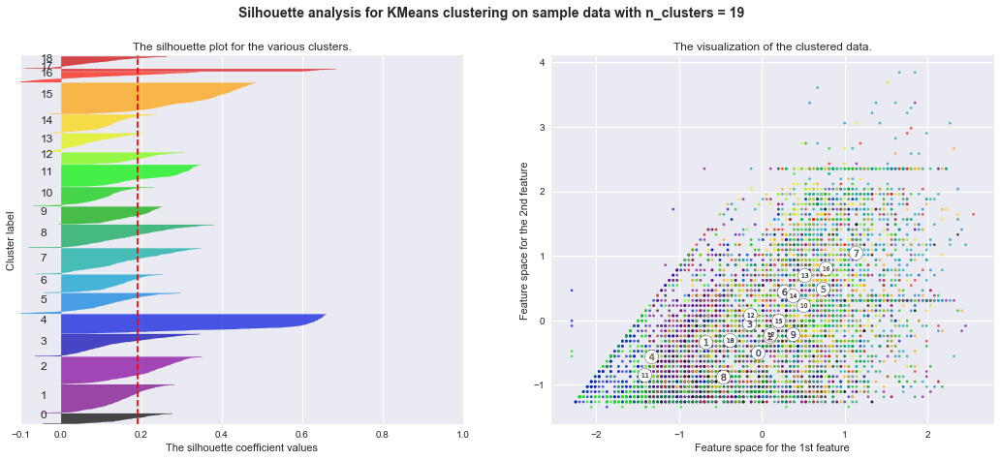

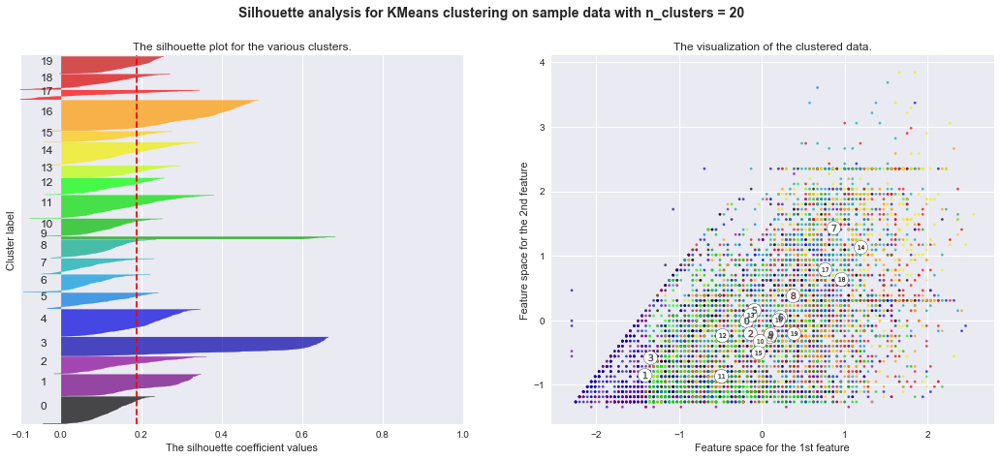

In [202]:
from __future__ import print_function

from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [2, 3, 4, 5, 6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(selector)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(selector, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(selector, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(selector[:, 0], selector[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Counter({4: 2720, 2: 2441, 5: 556, 3: 47, 0: 28, 1: 10})
0.2631578947368421
0.018890675241157555
0.16971916971916973
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.047s...
[t-SNE] Computed neighbors for 5802 samples in 1.412s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 0.556683
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.973221
[t-SNE] KL divergence after 500 iterations: 0.947584
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 KMeans Clusters on RFE')

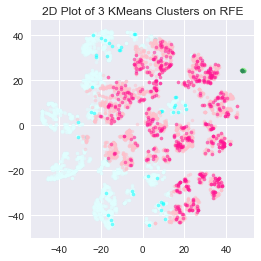

In [203]:
#Visualize the clusters versus the actual class labels
#perform the kmeans on reduced data
km_rfe = KMeans(n_clusters=3, random_state=0).fit(selector)
km_rfe.labels_

# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],km_rfe.labels_):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(selector)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 KMeans Clusters on RFE")
#plt.legend()

Counter({4: 3271, 2: 1627, 5: 557, 0: 291, 3: 36, 1: 20})
0.06430868167202572
0.02164762477450391
0.1455067920585162
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 5802 samples in 0.021s...
[t-SNE] Computed neighbors for 5802 samples in 1.204s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5802
[t-SNE] Computed conditional probabilities for sample 2000 / 5802
[t-SNE] Computed conditional probabilities for sample 3000 / 5802
[t-SNE] Computed conditional probabilities for sample 4000 / 5802
[t-SNE] Computed conditional probabilities for sample 5000 / 5802
[t-SNE] Computed conditional probabilities for sample 5802 / 5802
[t-SNE] Mean sigma: 0.556683
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.085884
[t-SNE] KL divergence after 500 iterations: 0.952074
[0, 1, 2, 3, 4, 5]


Text(0.5,1,'2D Plot of 3 Gaussian Mixtures on RFE')

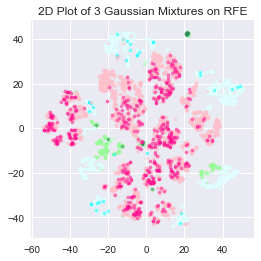

In [204]:
gaus_rfe = GaussianMixture(n_components=3, random_state=0).fit_predict(selector)

# Create the scatter
newlabels = []
for x, m in zip(df.iloc[:,0],gaus_rfe):
    if x == 0 and m == 0:
        newlabels.append(0)
    elif x == 1 and m == 0:
        newlabels.append(1)    
    elif x == 0 and m == 1:
        newlabels.append(2)
    elif x == 1 and m == 1:
        newlabels.append(3)
    elif x == 0 and m == 2:
        newlabels.append(4)
    elif x == 1 and m == 2:
        newlabels.append(5)
from collections import Counter
print(Counter(newlabels))   
print(Counter(newlabels)[1]/(Counter(newlabels)[0] + Counter(newlabels)[1]))
print(Counter(newlabels)[3]/(Counter(newlabels)[2] + Counter(newlabels)[3]))
print(Counter(newlabels)[5]/(Counter(newlabels)[4] + Counter(newlabels)[5]))

tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(selector)
        
labels=['Cluster 1 - Not Wealth Member','Cluster 1 - Wealth Member','Cluster 2 - Not Wealth Member','Cluster 2 - Wealth Member','Cluster 3 - Not Wealth Member','Cluster 3 - Wealth Member']
colours=['palegreen','seagreen','lightcyan','cyan','pink','deeppink']
unique = list(set(newlabels))
print(unique)
plt.figure( figsize=(4,4))
for i in range(6):
    xi = [list(tsne_results[:,0])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    yi = [list(tsne_results[:,1])[j] for j  in range(len(tsne_results)) if newlabels[j] == i]
    plt.scatter(xi, yi, c=colours[i], label=labels[i], alpha=0.5, s=10)
plt.title("2D Plot of 3 Gaussian Mixtures on RFE")
#plt.legend()

**Phase 5 - Applying Neural Network on Reduced Dimensions **

---


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\data.py:617: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:16: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  app.launch_new_instance()
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:17: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 7, 'hidden_layer_sizes': 5, 'max_iter': 125, 'solver': 'lbfgs'}
0.526562613430127
[[70  2]
 [ 6  6]]
              precision    recall  f1-score   support

           0      0.921     0.972     0.946        72
           1      0.750     0.500     0.600        12

   micro avg      0.905     0.905     0.905        84
   macro avg      0.836     0.736     0.773        84
weighted avg      0.897     0.905     0.897        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    4.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


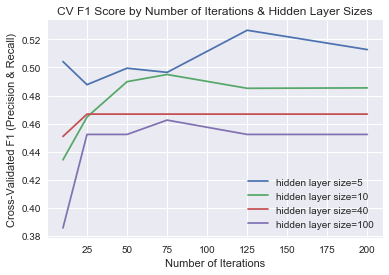

In [356]:
#Neural Network -- FUll DATA

y = df.iloc[:,0]
X = df.iloc[:,2:]

#split data into 85% train, 15% test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=0)

#instantiate a scalar
scaler = StandardScaler()

# Fit only to the training data
scaler.fit(X_train)

# Now apply the transformations to the data:
X_train_scale = scaler.transform(X_train)
X_test_scale = scaler.transform(X_test)
X_train_scale

#Neural Network Grid Search------------------------------------------------------
from sklearn.neural_network import MLPClassifier

#create gridSearch parameters
parameters = {'solver': ['lbfgs'], 'max_iter': [10,25,50,75,125,200], 'alpha': [7], 'hidden_layer_sizes':[5,10,40,100]}

#run GridSearch to optimize parameters
clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
clf.fit(X_train_scale,y_train)

#extract the best params from 'clf'
best_hyperparams = clf.best_params_
print(best_hyperparams)

#extract best CV score 
best_CV_score = clf.best_score_
print(best_CV_score)

#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train_scale,y_train)

#make predictions on test data
y_pred = best.predict(X_test_scale)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [10,25,50,75,125,200]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=5")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=40")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

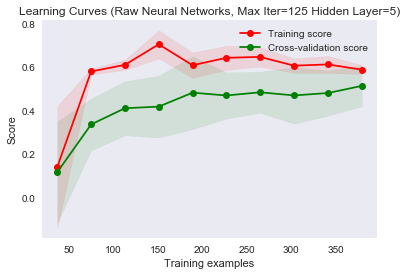

In [358]:
#plot the learning curve for Neural Network
title = "Learning Curves (Raw Neural Networks, Max Iter=125 Hidden Layer=5)"
plot_learning_curve(best_nn, title, X_train_scale, y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5, n_jobs=-1)
plt.show()

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 3, 'hidden_layer_sizes': 6, 'max_iter': 12, 'solver': 'lbfgs'}
0.5130191822891312
[[68  4]
 [ 7  5]]
              precision    recall  f1-score   support

           0      0.907     0.944     0.925        72
           1      0.556     0.417     0.476        12

   micro avg      0.869     0.869     0.869        84
   macro avg      0.731     0.681     0.701        84
weighted avg      0.857     0.869     0.861        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    2.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


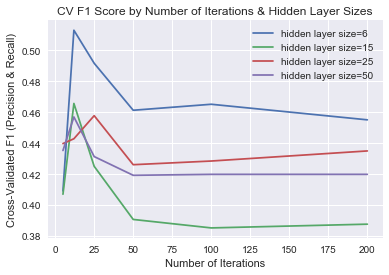

In [354]:
#Neural Network -- PCA Data

y = df.iloc[:,0]
X = df.iloc[:,2:]

#split data into 85% train, 15% test
X_train, X_test, y_train, y_test = train_test_split(pca_x, y, test_size=0.15, random_state=0)

#instantiate a scalar
#scaler = StandardScaler()

# Fit only to the training data
#scaler.fit(X_train)

# Now apply the transformations to the data:
#X_train_scale = scaler.transform(X_train)
#X_test_scale = scaler.transform(X_test)
#X_train_scale

#Neural Network Grid Search------------------------------------------------------
from sklearn.neural_network import MLPClassifier

#create gridSearch parameters
parameters = {'solver': ['lbfgs'], 'max_iter': [5,12,25,50,100,200], 'alpha': [3], 'hidden_layer_sizes':[6,15,25,50]}

#run GridSearch to optimize parameters
clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
clf.fit(X_train,y_train)

#extract the best params from 'clf'
best_hyperparams = clf.best_params_
print(best_hyperparams)

#extract best CV score 
best_CV_score = clf.best_score_
print(best_CV_score)

#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,12,25,50,100,200]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=6")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=15")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=50")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

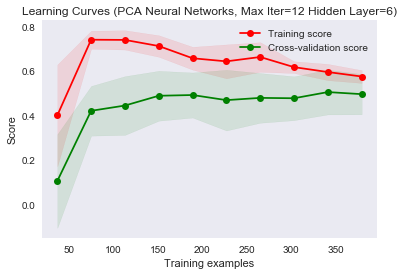

In [355]:
#plot the learning curve for Neural Network
title = "Learning Curves (PCA Neural Networks, Max Iter=12 Hidden Layer=6)"
plot_learning_curve(best_nn, title, X_train, y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5, n_jobs=-1)
plt.show()

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.009, 'hidden_layer_sizes': 50, 'max_iter': 100, 'solver': 'lbfgs'}
0.5000102185998782
[[67  5]
 [ 6  6]]
              precision    recall  f1-score   support

           0      0.918     0.931     0.924        72
           1      0.545     0.500     0.522        12

   micro avg      0.869     0.869     0.869        84
   macro avg      0.732     0.715     0.723        84
weighted avg      0.865     0.869     0.867        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    3.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


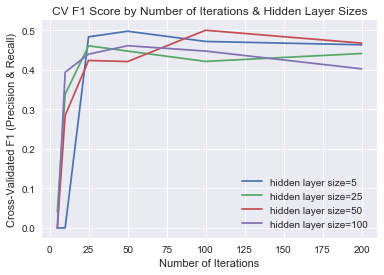

In [352]:
#Neural Network -- ICA DATA

y = df.iloc[:,0]
X = df.iloc[:,2:]

#split data into 85% train, 15% test
X_train, X_test, y_train, y_test = train_test_split(ica_x, y, test_size=0.15, random_state=0)

#instantiate a scalar
#scaler = StandardScaler()

# Fit only to the training data
#scaler.fit(X_train)

# Now apply the transformations to the data:
#X_train_scale = scaler.transform(X_train)
#X_test_scale = scaler.transform(X_test)
#X_train_scale

#Neural Network Grid Search------------------------------------------------------
from sklearn.neural_network import MLPClassifier

#create gridSearch parameters
parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,25,50,100,200], 'alpha': [0.009], 'hidden_layer_sizes':[5,25,50,100]}

#run GridSearch to optimize parameters
clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
clf.fit(X_train,y_train)

#extract the best params from 'clf'
best_hyperparams = clf.best_params_
print(best_hyperparams)

#extract best CV score 
best_CV_score = clf.best_score_
print(best_CV_score)

#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,10,25,50,100,200]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=5")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=50")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

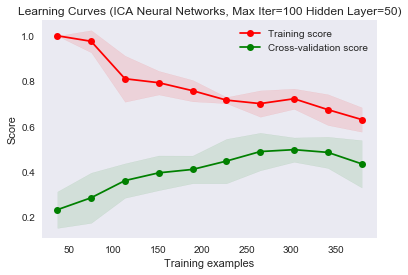

In [353]:
#plot the learning curve for Neural Network
title = "Learning Curves (ICA Neural Networks, Max Iter=100 Hidden Layer=50)"
plot_learning_curve(best_nn, title, X_train, y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5, n_jobs=-1)
plt.show()

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.00115, 'hidden_layer_sizes': 5, 'max_iter': 25, 'solver': 'lbfgs'}
0.5293231680600101
[[67  5]
 [ 7  5]]
              precision    recall  f1-score   support

           0      0.905     0.931     0.918        72
           1      0.500     0.417     0.455        12

   micro avg      0.857     0.857     0.857        84
   macro avg      0.703     0.674     0.686        84
weighted avg      0.847     0.857     0.852        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    2.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


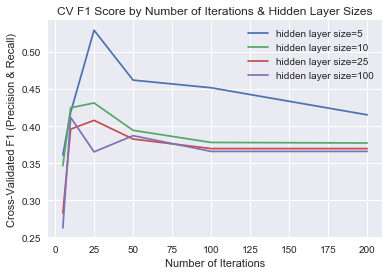

In [350]:
#Neural Network -- Random Projection DATA

y = df.iloc[:,0]
X = df.iloc[:,2:]

#split data into 85% train, 15% test
X_train, X_test, y_train, y_test = train_test_split(X_new, y, test_size=0.15, random_state=0)

#instantiate a scalar
#scaler = StandardScaler()

# Fit only to the training data
#scaler.fit(X_train)

# Now apply the transformations to the data:
#X_train_scale = scaler.transform(X_train)
#X_test_scale = scaler.transform(X_test)
#X_train_scale

#Neural Network Grid Search------------------------------------------------------
from sklearn.neural_network import MLPClassifier

#create gridSearch parameters
parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,25,50,100,200], 'alpha': [0.00115], 'hidden_layer_sizes':[5,10,25,100]}

#run GridSearch to optimize parameters
clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
clf.fit(X_train,y_train)

#extract the best params from 'clf'
best_hyperparams = clf.best_params_
print(best_hyperparams)

#extract best CV score 
best_CV_score = clf.best_score_
print(best_CV_score)

#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,10,25,50,100,200]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=5")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

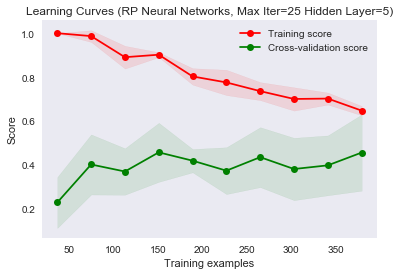

In [351]:
#plot the learning curve for Neural Network
title = "Learning Curves (RP Neural Networks, Max Iter=25 Hidden Layer=5)"
plot_learning_curve(best_nn, title, X_train, y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5, n_jobs=-1)
plt.show()

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:    3.2s


{'alpha': 2.75, 'hidden_layer_sizes': 10, 'max_iter': 40, 'solver': 'lbfgs'}
0.5499397563527235
[[69  3]
 [ 6  6]]
              precision    recall  f1-score   support

           0      0.920     0.958     0.939        72
           1      0.667     0.500     0.571        12

   micro avg      0.893     0.893     0.893        84
   macro avg      0.793     0.729     0.755        84
weighted avg      0.884     0.893     0.886        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    5.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


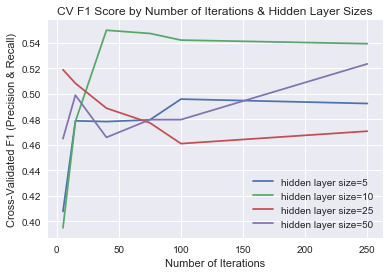

In [346]:
#Neural Network -- Recursive Feature Elimination DATA

y = df.iloc[:,0]
X = df.iloc[:,2:]

#split data into 85% train, 15% test
X_train, X_test, y_train, y_test = train_test_split(selector, y, test_size=0.15, random_state=0)

#instantiate a scalar
#scaler = StandardScaler()

# Fit only to the training data
#scaler.fit(X_train)

# Now apply the transformations to the data:
#X_train_scale = scaler.transform(X_train)
#X_test_scale = scaler.transform(X_test)
#X_train_scale

#Neural Network Grid Search------------------------------------------------------
from sklearn.neural_network import MLPClassifier

#create gridSearch parameters
parameters = {'solver': ['lbfgs'], 'max_iter': [5,15,40,75,100,250], 'alpha': [2.75], 'hidden_layer_sizes':[5,10,25,50]}

#run GridSearch to optimize parameters
clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
clf.fit(X_train,y_train)

#extract the best params from 'clf'
best_hyperparams = clf.best_params_
print(best_hyperparams)

#extract best CV score 
best_CV_score = clf.best_score_
print(best_CV_score)

#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,15,40,75,100,250]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=5")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=50")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

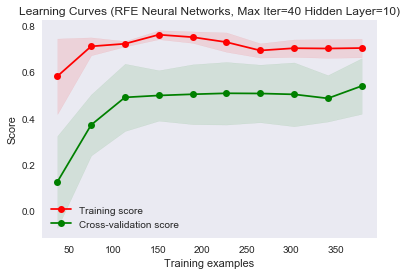

In [349]:
#plot the learning curve for Neural Network
title = "Learning Curves (RFE Neural Networks, Max Iter=40 Hidden Layer=10)"
plot_learning_curve(best_nn, title, X_train, y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5, n_jobs=-1)
plt.show()

**Phase 5 - Applying Neural Network on Clusters as Reduced Dimensions **

---

In [418]:
from sklearn.preprocessing import OneHotEncoder
km_pca = KMeans(n_clusters=7, random_state=0).fit(pca_x)
C = km_pca.labels_.reshape(-1, 1)
onehot_encoder = OneHotEncoder(sparse=False)
B = onehot_encoder.fit_transform(C)

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)


In [422]:
#Kmeans on PCA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmpca = []

for k in range(2,16):
    km_pca = KMeans(n_clusters=k, random_state=0).fit(pca_x)
    C = km_pca.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [15,25,35,250,1000], 'alpha': [5,3,2,1,0.5,0.1], 'hidden_layer_sizes':[3,4,5,6,8,100,250]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmpca.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 264 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:    8.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 5, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   10.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 5, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:    9.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 5, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   10.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.5, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.2446932580718659
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   10.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 5, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   11.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.5, 'hidden_layer_sizes': 4, 'max_iter': 15, 'solver': 'lbfgs'}
0.42628177112932103
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   12.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 5, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   12.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 15, 'solver': 'lbfgs'}
0.3321279106858054
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   11.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 3, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.4308864354372521
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 1043 out of 1050 | elapsed:   12.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   12.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncode

{'alpha': 2, 'hidden_layer_sizes': 3, 'max_iter': 25, 'solver': 'lbfgs'}
0.43685783904204956
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   12.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.1, 'hidden_layer_sizes': 6, 'max_iter': 15, 'solver': 'lbfgs'}
0.3759964012595592
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   12.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 3, 'hidden_layer_sizes': 3, 'max_iter': 15, 'solver': 'lbfgs'}
0.4310081071378712
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   13.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.1, 'hidden_layer_sizes': 4, 'max_iter': 15, 'solver': 'lbfgs'}
0.2884157560982688
Fitting 5 folds for each of 210 candidates, totalling 1050 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    3.7s


{'alpha': 0.1, 'hidden_layer_sizes': 4, 'max_iter': 15, 'solver': 'lbfgs'}
0.43675586692599744
0.43685783904204956
11


[Parallel(n_jobs=-1)]: Done 1050 out of 1050 | elapsed:   14.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


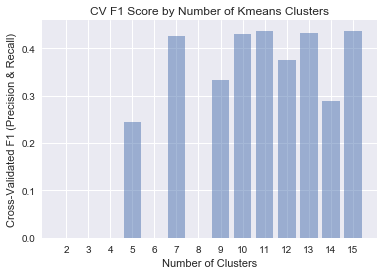

In [423]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvkmpca
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of Kmeans Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 2, 'hidden_layer_sizes': 3, 'max_iter': 25, 'solver': 'lbfgs'}
0.43685783904204956
0.43685783904204956
11
[[69  3]
 [ 7  5]]
              precision    recall  f1-score   support

           0      0.908     0.958     0.932        72
           1      0.625     0.417     0.500        12

   micro avg      0.881     0.881     0.881        84
   macro avg      0.766     0.688     0.716        84
weighted avg      0.867     0.881     0.871        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    1.2s finished


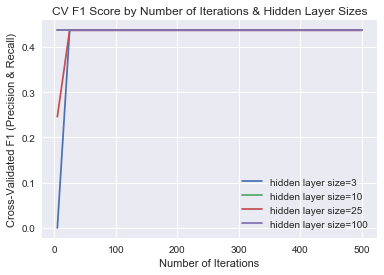

In [424]:
#Kmeans on PCA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(11,12):
    km_pca = KMeans(n_clusters=k, random_state=0).fit(pca_x)
    C = km_pca.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,25,50,100,350,500], 'alpha': [2], 'hidden_layer_sizes':[3,10,25,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,25,50,100,350,500]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=3")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

In [427]:
#Gaussian on PCA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvgauspca = []

for k in range(2,16):
    gaus_pca = GaussianMixture(n_components=k, random_state=0).fit_predict(pca_x)
    C = gaus_pca.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [3,5,10,15,20,25,100], 'alpha': [1,0.5,0.1,0.05,0.01,0.001], 'hidden_layer_sizes':[5,10,25,30,40,50,60]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvgauspca.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 264 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    6.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 1, 'hidden_layer_sizes': 5, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 520 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    6.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 1, 'hidden_layer_sizes': 5, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    7.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 1, 'hidden_layer_sizes': 5, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 520 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    8.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.5, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.41242961293176017
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    8.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.01, 'hidden_layer_sizes': 60, 'max_iter': 5, 'solver': 'lbfgs'}
0.2974489515324361
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    8.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.1, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.4069992224394002
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:   10.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 5, 'solver': 'lbfgs'}
0.35203594870827465
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:   10.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.5, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.26270921306574957
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    9.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.1, 'hidden_layer_sizes': 10, 'max_iter': 10, 'solver': 'lbfgs'}
0.33333325327236685
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    9.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.01, 'hidden_layer_sizes': 30, 'max_iter': 5, 'solver': 'lbfgs'}
0.33963228998882644
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 520 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:    9.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.01, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.3752749690317749
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:   10.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 15, 'solver': 'lbfgs'}
0.41162907268170423
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:   10.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now

{'alpha': 0.01, 'hidden_layer_sizes': 25, 'max_iter': 15, 'solver': 'lbfgs'}
0.39083299646966885
Fitting 5 folds for each of 294 candidates, totalling 1470 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    3.2s


{'alpha': 0.05, 'hidden_layer_sizes': 5, 'max_iter': 100, 'solver': 'lbfgs'}
0.3498129884835874
0.41242961293176017
5


[Parallel(n_jobs=-1)]: Done 1470 out of 1470 | elapsed:   10.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


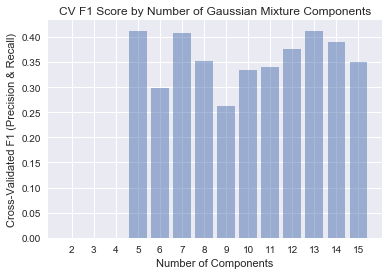

In [428]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvgauspca
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of Gaussian Mixture Components')
plt.xlabel('Number of Components')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.41242961293176017
0.41242961293176017
5
[[68  4]
 [ 7  5]]
              precision    recall  f1-score   support

           0      0.907     0.944     0.925        72
           1      0.556     0.417     0.476        12

   micro avg      0.869     0.869     0.869        84
   macro avg      0.731     0.681     0.701        84
weighted avg      0.857     0.869     0.861        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    2.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


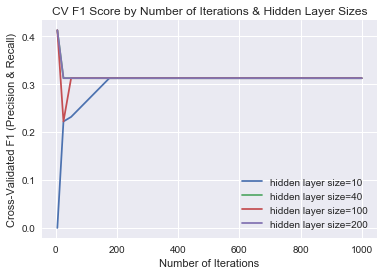

In [430]:
#Gaussian on PCA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(5,6):
    gaus_pca = GaussianMixture(n_components=k, random_state=0).fit_predict(pca_x)
    C = gaus_pca.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,25,50,175,500,1000], 'alpha': [0.1], 'hidden_layer_sizes':[10,40,100,200]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,25,50,175,500,1000]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=40")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=100")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=200")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

In [433]:
#Kmeans on ICA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmica = []

for k in range(2,16):
    km_ica = KMeans(n_clusters=k, random_state=0).fit(ica_x)
    C = km_ica.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,15,25,50,100,250], 'alpha': [2,0.1,0.001,0.00001], 'hidden_layer_sizes':[8,15,40,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmica.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    2.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.07058823529411765
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.1, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.19611971104231166
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.001, 'hidden_layer_sizes': 100, 'max_iter': 5, 'solver': 'lbfgs'}
0.379449157080736
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.1, 'hidden_layer_sizes': 100, 'max_iter': 5, 'solver': 'lbfgs'}
0.060606060606060594
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.07712743396953924
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 100, 'max_iter': 5, 'solver': 'lbfgs'}
0.10874929258630446
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 2, 'hidden_layer_sizes': 8, 'max_iter': 15, 'solver': 'lbfgs'}
0.39822064120875666
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.3483177772016247
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 2, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.22481500302480337
Fitting 5 folds for each of 96 candidates, totalling 480 fits
{'alpha': 0.001, 'hidden_layer_sizes': 100, 'max_iter': 5, 'solver': 'lbfgs'}
0.24976827094474152
0.39822064120875666
12


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


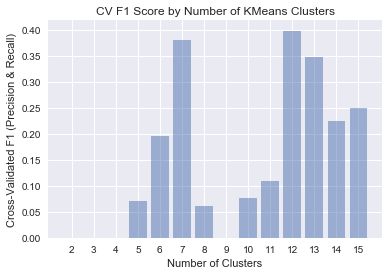

In [434]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvkmica
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of KMeans Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 2, 'hidden_layer_sizes': 8, 'max_iter': 15, 'solver': 'lbfgs'}
0.39822064120875666
0.39822064120875666
12
[[68  4]
 [10  2]]
              precision    recall  f1-score   support

           0      0.872     0.944     0.907        72
           1      0.333     0.167     0.222        12

   micro avg      0.833     0.833     0.833        84
   macro avg      0.603     0.556     0.564        84
weighted avg      0.795     0.833     0.809        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    1.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


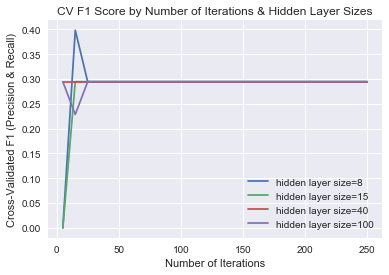

In [437]:
#Kmeans on ICA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(12,13):
    km_ica = KMeans(n_clusters=k, random_state=0).fit(ica_x)
    C = km_ica.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,15,25,50,100,250], 'alpha': [2], 'hidden_layer_sizes':[8,15,40,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,15,25,50,100,250]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=8")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=15")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=40")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

In [439]:
#Gaussian on ICA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvgausica = []

for k in range(2,16):
    gaus_ica = GaussianMixture(n_components=k, random_state=0).fit_predict(ica_x)
    C = gaus_ica.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [3,5,7], 'alpha': [0.05,0.01,0.005], 'hidden_layer_sizes':[50,60,70,80,90]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvgausica.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    0.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    0.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    0.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    0.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    0.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.05, 'hidden_layer_sizes': 90, 'max_iter': 3, 'solver': 'lbfgs'}
0.058823529411764705
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    0.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.05, 'hidden_layer_sizes': 60, 'max_iter': 5, 'solver': 'lbfgs'}
0.3896137264966666
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.05, 'hidden_layer_sizes': 60, 'max_iter': 5, 'solver': 'lbfgs'}
0.3896137264966666
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 5, 'solver': 'lbfgs'}
0.2896137264966666
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.01, 'hidden_layer_sizes': 70, 'max_iter': 5, 'solver': 'lbfgs'}
0.4016786825145958
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.05, 'hidden_layer_sizes': 90, 'max_iter': 5, 'solver': 'lbfgs'}
0.38444976076555026
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.05, 'hidden_layer_sizes': 60, 'max_iter': 5, 'solver': 'lbfgs'}
0.35206342780026983
Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.05, 'hidden_layer_sizes': 80, 'max_iter': 5, 'solver': 'lbfgs'}
0.28190194492196713
Fitting 5 folds for each of 45 candidates, totalling 225 fits
{'alpha': 0.05, 'hidden_layer_sizes': 50, 'max_iter': 5, 'solver': 'lbfgs'}
0.35407593317093583
0.4016786825145958
11


[Parallel(n_jobs=-1)]: Done 225 out of 225 | elapsed:    1.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


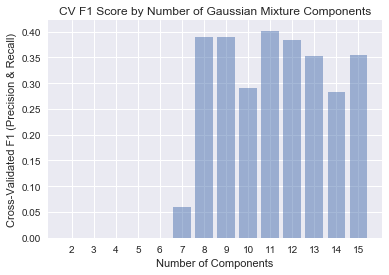

In [440]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvgausica
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of Gaussian Mixture Components')
plt.xlabel('Number of Components')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Done  72 out of 120 | elapsed:    1.0s remaining:    0.6s


{'alpha': 0.01, 'hidden_layer_sizes': 70, 'max_iter': 5, 'solver': 'lbfgs'}
0.4016786825145958
0.4016786825145958
11
[[68  4]
 [ 8  4]]
              precision    recall  f1-score   support

           0      0.895     0.944     0.919        72
           1      0.500     0.333     0.400        12

   micro avg      0.857     0.857     0.857        84
   macro avg      0.697     0.639     0.659        84
weighted avg      0.838     0.857     0.845        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    2.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


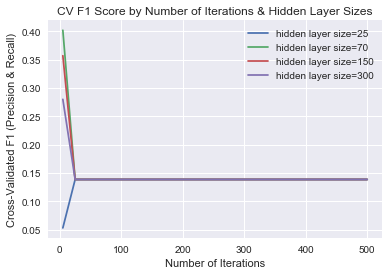

In [441]:
#Gaussian on PCA -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(11,12):
    gaus_ica = GaussianMixture(n_components=k, random_state=0).fit_predict(ica_x)
    C = gaus_ica.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,25,50,100,300,500], 'alpha': [0.01], 'hidden_layer_sizes':[25,70,150,300]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,25,50,100,300,500]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=70")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=150")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=300")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

In [444]:
#Kmeans on Random Projections -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmrp = []

for k in range(2,16):
    km_rp = KMeans(n_clusters=k, random_state=0).fit(X_new)
    C = km_rp.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,40,50,60,250,500], 'alpha': [1,0.05,0.01,0.005,], 'hidden_layer_sizes':[8,10,20,15,70,100,200]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmrp.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:    5.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 1, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:    5.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 1, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:    6.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 1, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:    6.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 1, 'hidden_layer_sizes': 200, 'max_iter': 5, 'solver': 'lbfgs'}
0.2179979360165119
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:    7.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.05, 'hidden_layer_sizes': 15, 'max_iter': 5, 'solver': 'lbfgs'}
0.29057464979062075
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:    8.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.05, 'hidden_layer_sizes': 15, 'max_iter': 10, 'solver': 'lbfgs'}
0.258884907523746
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 411 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:    9.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 1, 'hidden_layer_sizes': 8, 'max_iter': 5, 'solver': 'lbfgs'}
0.3133106269948375
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:   10.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 1, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.3034205171047276
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 264 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:   10.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 1, 'hidden_layer_sizes': 200, 'max_iter': 5, 'solver': 'lbfgs'}
0.31656893126600383
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 232 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:   11.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.01, 'hidden_layer_sizes': 10, 'max_iter': 40, 'solver': 'lbfgs'}
0.35674234889868633
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:   10.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 1, 'hidden_layer_sizes': 70, 'max_iter': 5, 'solver': 'lbfgs'}
0.30741770069916524
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:   12.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 1, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.30803308531454987
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:   11.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.05, 'hidden_layer_sizes': 10, 'max_iter': 10, 'solver': 'lbfgs'}
0.27923823544876175
Fitting 5 folds for each of 196 candidates, totalling 980 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    5.1s


{'alpha': 0.01, 'hidden_layer_sizes': 10, 'max_iter': 50, 'solver': 'lbfgs'}
0.3722689370813017
0.3722689370813017
15


[Parallel(n_jobs=-1)]: Done 980 out of 980 | elapsed:   11.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


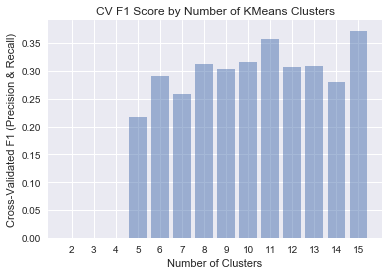

In [445]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvkmrp
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of KMeans Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 0.01, 'hidden_layer_sizes': 10, 'max_iter': 50, 'solver': 'lbfgs'}
0.3722689370813017
0.3722689370813017
15
[[67  5]
 [ 8  4]]
              precision    recall  f1-score   support

           0      0.893     0.931     0.912        72
           1      0.444     0.333     0.381        12

   micro avg      0.845     0.845     0.845        84
   macro avg      0.669     0.632     0.646        84
weighted avg      0.829     0.845     0.836        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    1.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


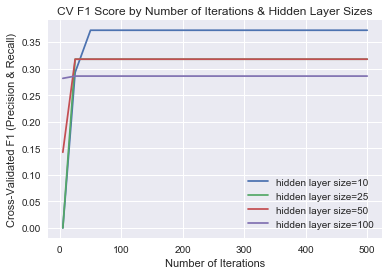

In [447]:
#Kmeans on Random Projections -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(15,16):
    km_rp = KMeans(n_clusters=k, random_state=0).fit(X_new)
    C = km_rp.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,25,50,100,250,500], 'alpha': [0.01], 'hidden_layer_sizes':[10,25,50,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,25,50,100,250,500]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=50")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

In [451]:
#Gaussian on Random Projections -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvgausrp = []

for k in range(2,16):
    gaus_rp = GaussianMixture(n_components=k, random_state=0).fit_predict(X_new)
    C = gaus_rp.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,25,50,100,250], 'alpha': [10,1,0.1,0.0001], 'hidden_layer_sizes':[10,25,40,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvgausrp.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 232 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 1, 'hidden_layer_sizes': 25, 'max_iter': 5, 'solver': 'lbfgs'}
0.1406060606060606
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.35967690487215104
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.0001, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.20466460268317851
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 25, 'max_iter': 5, 'solver': 'lbfgs'}
0.2753412944125018
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 1, 'hidden_layer_sizes': 100, 'max_iter': 5, 'solver': 'lbfgs'}
0.14215538847117792
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.2577256580886345
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 25, 'max_iter': 5, 'solver': 'lbfgs'}
0.34206384447471033
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 232 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 10, 'max_iter': 10, 'solver': 'lbfgs'}
0.31664070521130416
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    3.3s


{'alpha': 0.0001, 'hidden_layer_sizes': 25, 'max_iter': 25, 'solver': 'lbfgs'}
0.29005909645909644
0.35967690487215104
7


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


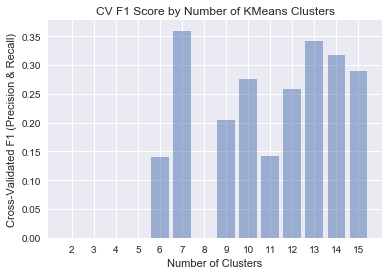

In [452]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvgausrp
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of KMeans Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 0.01, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.35967690487215104
0.35967690487215104
7
[[64  8]
 [ 8  4]]
              precision    recall  f1-score   support

           0      0.889     0.889     0.889        72
           1      0.333     0.333     0.333        12

   micro avg      0.810     0.810     0.810        84
   macro avg      0.611     0.611     0.611        84
weighted avg      0.810     0.810     0.810        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    0.6s finished


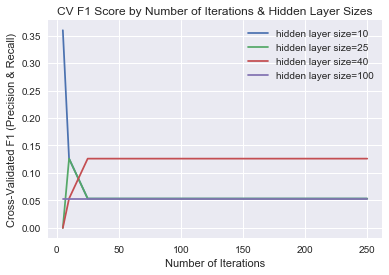

In [453]:
#Gaussian on Random Projections -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(7,8):
    gaus_rp = GaussianMixture(n_components=k, random_state=0).fit_predict(X_new)
    C = gaus_rp.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,25,50,100,250], 'alpha': [0.01], 'hidden_layer_sizes':[10,25,40,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,10,25,50,100,250]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=40")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

In [456]:
#Kmeans on RFE -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmrfe = []

for k in range(2,16):
    km_rfe = KMeans(n_clusters=k, random_state=0).fit(selector)
    C = km_rfe.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,25,50,100,250], 'alpha': [2,0.1,0.001,0.00001], 'hidden_layer_sizes':[5,25,40,100]}
    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmrfe.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    2.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    2.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 5, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 25, 'max_iter': 5, 'solver': 'lbfgs'}
0.333289012162976
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.001, 'hidden_layer_sizes': 25, 'max_iter': 5, 'solver': 'lbfgs'}
0.33127220544028696
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 25, 'max_iter': 5, 'solver': 'lbfgs'}
0.41757575757575754
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    6.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 5, 'solver': 'lbfgs'}
0.4154367201426025
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    6.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 25, 'max_iter': 5, 'solver': 'lbfgs'}
0.4202272727272727
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 25, 'solver': 'lbfgs'}
0.42738765712947546
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.4385984427141268
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 25, 'solver': 'lbfgs'}
0.4303984098176475
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 2, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.4115816696914701
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 5, 'solver': 'lbfgs'}
0.41662690058479535
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.34788922452759463
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    4.6s


{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.4069775828460039
0.4385984427141268
10


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


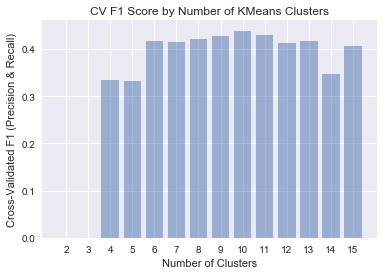

In [457]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvkmrfe
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of KMeans Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.4385984427141268
0.4385984427141268
10
[[70  2]
 [ 7  5]]
              precision    recall  f1-score   support

           0      0.909     0.972     0.940        72
           1      0.714     0.417     0.526        12

   micro avg      0.893     0.893     0.893        84
   macro avg      0.812     0.694     0.733        84
weighted avg      0.881     0.893     0.881        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    1.0s finished


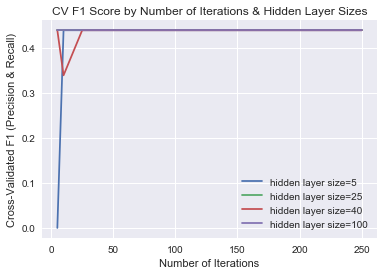

In [458]:
#Kmeans on RFE -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(10,11):
    km_rfe = KMeans(n_clusters=k, random_state=0).fit(selector)
    C = km_rfe.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,25,50,100,250], 'alpha': [2], 'hidden_layer_sizes':[5,25,40,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,10,25,50,100,250]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=5")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=40")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

In [461]:
#Gaussian on RFE -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvgausrfe = []

for k in range(2,16):
    gaus_rfe = GaussianMixture(n_components=k, random_state=0).fit_predict(selector)
    C = gaus_rfe.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [10,25,50,100,250,500], 'alpha': [10,2,0.1,0.001], 'hidden_layer_sizes':[5,25,40,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvgausrfe.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 264 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 232 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    3.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 10, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.4045183898340726
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    4.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 10, 'solver': 'lbfgs'}
0.2236762845709147
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 100, 'max_iter': 10, 'solver': 'lbfgs'}
0.31420846394984325
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarn

{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.42763978912799233
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 232 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 25, 'solver': 'lbfgs'}
0.4250591439667021
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.40930894241874277
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 25, 'solver': 'lbfgs'}
0.3115816696914701
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 10, 'solver': 'lbfgs'}
0.31571075577566454
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now u

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.26990757390757386
Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    3.1s


{'alpha': 0.001, 'hidden_layer_sizes': 40, 'max_iter': 10, 'solver': 'lbfgs'}
0.4037291733607523
0.42763978912799233
9


[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:    5.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


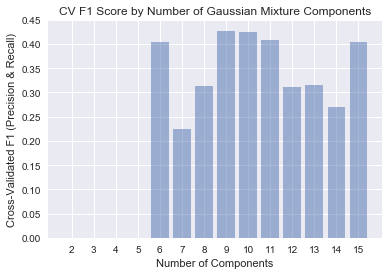

In [462]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvgausrfe
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of Gaussian Mixture Components')
plt.xlabel('Number of Components')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
{'alpha': 0.01, 'hidden_layer_sizes': 10, 'max_iter': 10, 'solver': 'lbfgs'}
0.42763978912799233
0.42763978912799233
9
[[70  2]
 [ 7  5]]
              precision    recall  f1-score   support

           0      0.909     0.972     0.940        72
           1      0.714     0.417     0.526        12

   micro avg      0.893     0.893     0.893        84
   macro avg      0.812     0.694     0.733        84
weighted avg      0.881     0.893     0.881        84



[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    1.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


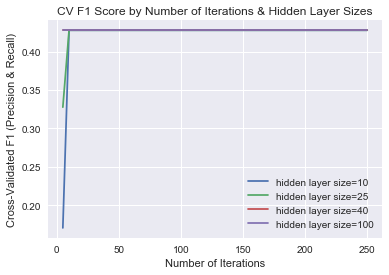

In [463]:
#Gaussian on RFE -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0

for k in range(9,10):
    gaus_rfe = GaussianMixture(n_components=k, random_state=0).fit_predict(selector)
    C = gaus_rfe.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [5,10,25,50,100,250], 'alpha': [0.01], 'hidden_layer_sizes':[10,25,40,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k

print(bestcv)
print(bestk)
        
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
#plt.figure()
#plot_confusion_matrix(cnf_matrix, classes=["No Wealth Relationship", "Wealth Relationship"], title='Confusion matrix')

# plot the results showing cross-validated F1 scores by hidden layer sizes and number of model iterations
xp = [5,10,25,50,100,250]
plt.plot(xp, list(clf.cv_results_['mean_test_score'][:6]), label="hidden layer size=10")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][6:12]), label="hidden layer size=25")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][12:18]), label="hidden layer size=40")
plt.plot(xp, list(clf.cv_results_['mean_test_score'][18:]), label="hidden layer size=100")
plt.title('CV F1 Score by Number of Iterations & Hidden Layer Sizes')
plt.xlabel('Number of Iterations')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.legend()

**Phase 6 - Applying Neural Network on Clusters on PCA on RFE **

---

In [466]:
#Perform PCA on the NHL Data
from sklearn.decomposition import PCA
pca = PCA(n_components=17)
pca_rf = pca.fit(selector)
print(pca_rf.explained_variance_ratio_)

[0.37 0.11 0.1  0.09 0.07 0.05 0.05 0.04 0.03 0.03 0.02 0.01 0.01 0.01
 0.01 0.   0.  ]


Text(0,0.5,'Cumulative Variance Explained')

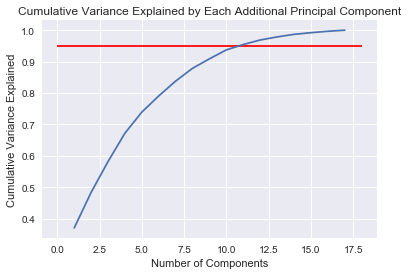

In [467]:
sum_ = []
sum_no = 0.0
for x in pca_rf.explained_variance_ratio_:
    sum_no += x
    sum_.append(sum_no)
sum_

# plot the variance explained by each new component
plt.plot(range(1,18,1), sum_)
plt.hlines(0.95, 0, 18, colors='red')
plt.title('Cumulative Variance Explained by Each Additional Principal Component')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Variance Explained')

In [539]:
#Perform PCA on the NHL Data
from sklearn.decomposition import PCA
pca = PCA(n_components=1)
pca_rf = pca.fit_transform(selector)
pca_rf

array([[ 3.75],
       [ 4.79],
       [ 4.47],
       [ 3.49],
       [ 6.57],
       [ 4.45],
       [ 3.46],
       [ 3.79],
       [ 3.93],
       [ 3.66],
       [ 3.73],
       [ 3.58],
       [ 2.06],
       [ 5.14],
       [ 0.6 ],
       [ 3.17],
       [ 3.64],
       [ 2.98],
       [ 2.67],
       [ 4.8 ],
       [ 1.83],
       [ 3.51],
       [ 3.26],
       [ 4.26],
       [ 3.7 ],
       [ 2.34],
       [ 3.55],
       [ 3.38],
       [ 4.27],
       [ 0.89],
       [ 3.24],
       [ 4.1 ],
       [ 3.73],
       [ 1.94],
       [ 4.01],
       [ 4.22],
       [ 1.75],
       [ 2.72],
       [ 0.68],
       [ 3.25],
       [ 2.6 ],
       [ 2.23],
       [ 5.  ],
       [ 1.74],
       [ 0.14],
       [ 4.  ],
       [-0.53],
       [-0.56],
       [ 4.22],
       [ 0.14],
       [ 0.34],
       [ 0.1 ],
       [ 0.41],
       [ 1.55],
       [ 3.75],
       [ 0.15],
       [ 1.6 ],
       [ 1.14],
       [-3.45],
       [ 0.68],
       [ 1.12],
       [ 0.06],
       [

In [540]:
#Kmeans on RFE -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmpcarfe = []

for k in range(2,16):
    km_pcarfe = KMeans(n_clusters=k, random_state=0).fit(pca_rf)
    C = km_pcarfe.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [3,5,7,10,25,50,100,250], 'alpha': [12.5,10,5,4,3,2,1,0.5,0.1,0.01,0.001,0.0001], 'hidden_layer_sizes':[3,5,7,10,25,40,70,100]}
    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmpcarfe.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 2472 tasks      | elapsed:   11.2s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   16.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 2472 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   18.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 3368 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   18.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 2920 tasks      | elapsed:   14.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   18.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 2783 tasks      | elapsed:   17.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   23.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 5, 'solver': 'lbfgs'}
0.1856479909451047
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 3144 tasks      | elapsed:   17.2s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   21.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 0.1, 'hidden_layer_sizes': 25, 'max_iter': 7, 'solver': 'lbfgs'}
0.15541197822141561
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 3368 tasks      | elapsed:   18.3s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   21.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 520 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 3592 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   22.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 0.1, 'hidden_layer_sizes': 3, 'max_iter': 5, 'solver': 'lbfgs'}
0.04
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 3144 tasks      | elapsed:   17.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   21.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 3, 'hidden_layer_sizes': 25, 'max_iter': 7, 'solver': 'lbfgs'}
0.3186631806903566
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 520 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 3368 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   24.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 0.5, 'hidden_layer_sizes': 25, 'max_iter': 7, 'solver': 'lbfgs'}
0.29632035333087964
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 2920 tasks      | elapsed:   17.5s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   22.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 0.1, 'hidden_layer_sizes': 40, 'max_iter': 7, 'solver': 'lbfgs'}
0.29167760587869473
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 3018 tasks      | elapsed:   18.9s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   25.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 2, 'hidden_layer_sizes': 100, 'max_iter': 10, 'solver': 'lbfgs'}
0.2631704042715484
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 2920 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   24.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 1, 'hidden_layer_sizes': 10, 'max_iter': 10, 'solver': 'lbfgs'}
0.2631704042715484
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 2696 tasks      | elapsed:   16.9s


{'alpha': 1, 'hidden_layer_sizes': 10, 'max_iter': 5, 'solver': 'lbfgs'}
0.2631704042715484
0.3186631806903566
10


[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   25.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


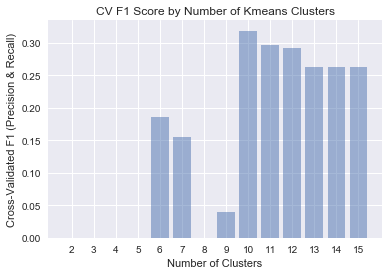

In [541]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvkmpcarfe
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of Kmeans Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

In [542]:
#Gaussian on RFE -- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvgauspcarfe = []

for k in range(2,16):
    gaus_pcarfe = GaussianMixture(n_components=k, random_state=0).fit_predict(pca_rf)
    C = gaus_pcarfe.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(B, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [3,5,7,10,25,50,100,250], 'alpha': [12.5,10,5,4,3,2,1,0.5,0.1,0.01,0.001,0.0001], 'hidden_layer_sizes':[3,5,7,10,25,40,70,100]}

    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvgauspcarfe.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 2472 tasks      | elapsed:   11.3s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   16.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 3144 tasks      | elapsed:   14.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   17.1s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 3144 tasks      | elapsed:   16.0s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   18.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 2024 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   20.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


{'alpha': 12.5, 'hidden_layer_sizes': 3, 'max_iter': 3, 'solver': 'lbfgs'}
0.0
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 2696 tasks      | elapsed:   14.9s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   21.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 0.1, 'hidden_layer_sizes': 3, 'max_iter': 5, 'solver': 'lbfgs'}
0.21128901658613033
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 2696 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   21.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 0.01, 'hidden_layer_sizes': 40, 'max_iter': 7, 'solver': 'lbfgs'}
0.09295546558704454
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 2920 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   21.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 1, 'hidden_layer_sizes': 25, 'max_iter': 7, 'solver': 'lbfgs'}
0.25382121971595656
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 3368 tasks      | elapsed:   21.5s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   24.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 1, 'hidden_layer_sizes': 70, 'max_iter': 7, 'solver': 'lbfgs'}
0.3186631806903566
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 3368 tasks      | elapsed:   19.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   22.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 2, 'hidden_layer_sizes': 25, 'max_iter': 7, 'solver': 'lbfgs'}
0.3186631806903566
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 2920 tasks      | elapsed:   17.5s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   22.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 2, 'hidden_layer_sizes': 25, 'max_iter': 7, 'solver': 'lbfgs'}
0.3290979632990522
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 424 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 2920 tasks      | elapsed:   18.2s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   23.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 3, 'hidden_layer_sizes': 100, 'max_iter': 7, 'solver': 'lbfgs'}
0.34179637599746493
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 2696 tasks      | elapsed:   16.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   24.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 2, 'hidden_layer_sizes': 70, 'max_iter': 7, 'solver': 'lbfgs'}
0.3290979632990522
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 3368 tasks      | elapsed:   20.7s
[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   24.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 2, 'hidden_layer_sizes': 25, 'max_iter': 7, 'solver': 'lbfgs'}
0.27566315789473683
Fitting 5 folds for each of 768 candidates, totalling 3840 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 3248 tasks      | elapsed:   21.4s


{'alpha': 2, 'hidden_layer_sizes': 100, 'max_iter': 10, 'solver': 'lbfgs'}
0.1410001684052027
0.34179637599746493
12


[Parallel(n_jobs=-1)]: Done 3840 out of 3840 | elapsed:   25.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


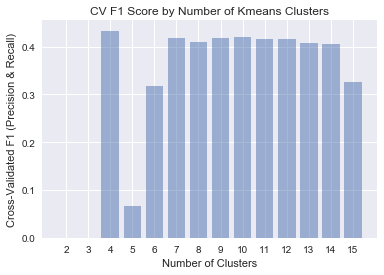

In [473]:
objects = range(2,16)
y_pos = np.arange(len(objects))
performance = listcvgauspcarfe
 
plt.bar(y_pos, performance, align='center', alpha=0.5)
plt.xticks(y_pos, objects)
plt.title('CV F1 Score by Number of Gaussian Mixture Components')
plt.xlabel('Number of Components')
plt.ylabel('Cross-Validated F1 (Precision & Recall)')
plt.show()

**Phase 7 - Applying Neural Network on Clusters on PCA on RFE Added to RFE**

---

In [608]:
#Perform PCA on the NHL Data
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
pca_rf = pca.fit_transform(selector)
pca_rf

array([[ 3.75, -0.51,  0.29],
       [ 4.79, -1.01,  0.3 ],
       [ 4.47, -0.57,  0.05],
       ...,
       [ 4.03,  0.55, -1.53],
       [-2.6 ,  0.98,  0.38],
       [ 4.66,  2.5 ,  1.72]])

In [551]:
throw = np.concatenate((pca_rf, selector), axis=1)
throw[0]

array([ 3.75, -0.51,  0.29, -1.23,  0.17,  0.38, -0.07, -0.04,  2.65,
       -0.61, -0.59,  1.77, -0.48,  1.19, -0.46,  0.32, -1.21,  0.73,
        1.11,  0.45,  0.23,  1.78, -0.44,  0.19,  1.41])

In [606]:
#Kmeans on PCA on RFE Added to RFE-- Labels Alone
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmrfe = []

for k in range(2,16):
    
    km_rfe = KMeans(n_clusters=k, random_state=0).fit(pca_rf)
    C = km_rfe.labels_.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)
    
    D = np.concatenate((B, selector), axis=1)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(D, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [3,5,7,10,25,50,100,250,500], 'alpha': [6,5,4,3,2,1,0.5,0.1,0.01], 'hidden_layer_sizes':[2,3,4,5,6,7,10,25,40,70]}
    #parameters = {'solver': ['lbfgs'], 'max_iter': [15,20,25,30,35,40,45], 'alpha': [2.5,2.25,2,1.75,1.5], 'hidden_layer_sizes':[15,20,25,30,35]}
    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmrfe.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 972 tasks      | elapsed:   16.3s
[Parallel(n_jobs=-1)]: Done 1772 tasks      | elapsed:   29.6s
[Parallel(n_jobs=-1)]: Done 2892 tasks      | elapsed:   50.0s
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.2min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the futur

{'alpha': 2, 'hidden_layer_sizes': 5, 'max_iter': 250, 'solver': 'lbfgs'}
0.5480075187969925
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 458 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 1052 tasks      | elapsed:   17.9s
[Parallel(n_jobs=-1)]: Done 1536 tasks      | elapsed:   26.7s
[Parallel(n_jobs=-1)]: Done 2391 tasks      | elapsed:   42.3s
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.2min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the futu

{'alpha': 2, 'hidden_layer_sizes': 25, 'max_iter': 50, 'solver': 'lbfgs'}
0.5648562424403831
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 968 tasks      | elapsed:   17.9s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:   34.0s
[Parallel(n_jobs=-1)]: Done 2888 tasks      | elapsed:   55.2s
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.3min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the futur

{'alpha': 6, 'hidden_layer_sizes': 5, 'max_iter': 5, 'solver': 'lbfgs'}
0.5454004664066584
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 836 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done 1476 tasks      | elapsed:   29.8s
[Parallel(n_jobs=-1)]: Done 2372 tasks      | elapsed:   46.7s
[Parallel(n_jobs=-1)]: Done 3524 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.3min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will 

{'alpha': 0.5, 'hidden_layer_sizes': 5, 'max_iter': 25, 'solver': 'lbfgs'}
0.5559078299196267
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 473 tasks      | elapsed:    7.4s
[Parallel(n_jobs=-1)]: Done 1231 tasks      | elapsed:   19.2s
[Parallel(n_jobs=-1)]: Done 2351 tasks      | elapsed:   40.5s
[Parallel(n_jobs=-1)]: Done 3919 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 4043 out of 4050 | elapsed:  1.2min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.2min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in 

{'alpha': 1, 'hidden_layer_sizes': 5, 'max_iter': 50, 'solver': 'lbfgs'}
0.5611616137116985
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 1212 tasks      | elapsed:   18.9s
[Parallel(n_jobs=-1)]: Done 2332 tasks      | elapsed:   40.7s
[Parallel(n_jobs=-1)]: Done 3764 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.2min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the futu

{'alpha': 2, 'hidden_layer_sizes': 4, 'max_iter': 25, 'solver': 'lbfgs'}
0.5499968966269775
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 1076 tasks      | elapsed:   18.8s
[Parallel(n_jobs=-1)]: Done 2036 tasks      | elapsed:   36.7s
[Parallel(n_jobs=-1)]: Done 3380 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.2min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the futu

{'alpha': 1, 'hidden_layer_sizes': 6, 'max_iter': 25, 'solver': 'lbfgs'}
0.5410826106242066
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    7.2s
[Parallel(n_jobs=-1)]: Done 1379 tasks      | elapsed:   24.3s
[Parallel(n_jobs=-1)]: Done 2179 tasks      | elapsed:   38.1s
[Parallel(n_jobs=-1)]: Done 3299 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.2min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the futu

{'alpha': 3, 'hidden_layer_sizes': 6, 'max_iter': 50, 'solver': 'lbfgs'}
0.5359796264855687
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    7.0s
[Parallel(n_jobs=-1)]: Done 1088 tasks      | elapsed:   19.1s
[Parallel(n_jobs=-1)]: Done 1658 tasks      | elapsed:   29.4s
[Parallel(n_jobs=-1)]: Done 3146 tasks      | elapsed:   58.9s
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.4min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


{'alpha': 0.1, 'hidden_layer_sizes': 2, 'max_iter': 100, 'solver': 'lbfgs'}
0.5485323380060222
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 757 tasks      | elapsed:   14.9s
[Parallel(n_jobs=-1)]: Done 1397 tasks      | elapsed:   30.9s
[Parallel(n_jobs=-1)]: Done 2293 tasks      | elapsed:   52.6s
[Parallel(n_jobs=-1)]: Done 3445 tasks      | elapsed:  1.2min
[Pa

{'alpha': 0.1, 'hidden_layer_sizes': 5, 'max_iter': 10, 'solver': 'lbfgs'}
0.5432023027161978
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 942 tasks      | elapsed:   20.9s
[Parallel(n_jobs=-1)]: Done 1512 tasks      | elapsed:   34.7s
[Parallel(n_jobs=-1)]: Done 2408 tasks      | elapsed:   58.0s
[Parallel(n_jobs=-1)]: Done 3560 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.5min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will 

{'alpha': 1, 'hidden_layer_sizes': 10, 'max_iter': 25, 'solver': 'lbfgs'}
0.5556286549707603
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    6.9s
[Parallel(n_jobs=-1)]: Done 1076 tasks      | elapsed:   19.1s
[Parallel(n_jobs=-1)]: Done 2036 tasks      | elapsed:   37.6s
[Parallel(n_jobs=-1)]: Done 3380 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.3min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


{'alpha': 0.5, 'hidden_layer_sizes': 40, 'max_iter': 250, 'solver': 'lbfgs'}
0.5534728979311023
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 472 tasks      | elapsed:    7.8s
[Parallel(n_jobs=-1)]: Done 1116 tasks      | elapsed:   21.1s
[Parallel(n_jobs=-1)]: Done 1756 tasks      | elapsed:   34.7s
[Parallel(n_jobs=-1)]: Done 2652 tasks      | elapsed:   54.4s
[Parallel(n_jobs=-1)]: Done 3804 tasks      | elapsed:  1.3min
[P

{'alpha': 5, 'hidden_layer_sizes': 5, 'max_iter': 100, 'solver': 'lbfgs'}
0.5328784029038113
Fitting 5 folds for each of 810 candidates, totalling 4050 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 1088 tasks      | elapsed:   18.8s
[Parallel(n_jobs=-1)]: Done 2048 tasks      | elapsed:   38.0s
[Parallel(n_jobs=-1)]: Done 3215 tasks      | elapsed:  1.1min


{'alpha': 3, 'hidden_layer_sizes': 5, 'max_iter': 25, 'solver': 'lbfgs'}
0.5501698691172375
0.5648562424403831
3


[Parallel(n_jobs=-1)]: Done 4043 out of 4050 | elapsed:  1.4min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 4050 out of 4050 | elapsed:  1.4min finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


In [607]:
#Gaussian on PCA on RFE Added to RFE-- Labels Plus DATA
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmrfe = []

for k in range(2,16):
    
    gaus_pcarfe = GaussianMixture(n_components=k, random_state=0).fit_predict(pca_rf)
    C = gaus_pcarfe.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)
    
    D = np.concatenate((B, selector), axis=1)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(D, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [3,5,7,10,25,50,100,250], 'alpha': [6,5,4,3,2,1,0.5,0.1], 'hidden_layer_sizes':[2,3,4,5,6,7,10,25,40,70]}
    #parameters = {'solver': ['lbfgs'], 'max_iter': [33,35,37], 'alpha': [1,0.9,1.1], 'hidden_layer_sizes':[4]}
    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmrfe.append(best_CV_score)
print(bestcv)
print(bestk)
        


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 1604 tasks      | elapsed:   18.0s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   35.9s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 2, 'hidden_layer_sizes': 4, 'max_iter': 100, 'solver': 'lbfgs'}
0.5537719298245614
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    4.5s
[Parallel(n_jobs=-1)]: Done 1884 tasks      | elapsed:   19.1s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   35.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 1, 'hidden_layer_sizes': 3, 'max_iter': 50, 'solver': 'lbfgs'}
0.5465757446384736
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 264 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 1800 tasks      | elapsed:   19.7s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   36.6s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 5, 'hidden_layer_sizes': 4, 'max_iter': 7, 'solver': 'lbfgs'}
0.5449046663579771
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 1652 tasks      | elapsed:   17.6s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   36.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 3, 'hidden_layer_sizes': 2, 'max_iter': 100, 'solver': 'lbfgs'}
0.5446348278706213
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:   20.5s
[Parallel(n_jobs=-1)]: Done 2128 tasks      | elapsed:   33.4s
[Parallel(n_jobs=-1)]: Done 3193 out of 3200 | elapsed:   52.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   53.2s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.


{'alpha': 1, 'hidden_layer_sizes': 7, 'max_iter': 25, 'solver': 'lbfgs'}
0.5754407963482373
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 380 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 1004 tasks      | elapsed:   13.8s
[Parallel(n_jobs=-1)]: Done 1964 tasks      | elapsed:   25.1s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   40.5s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categor

{'alpha': 2, 'hidden_layer_sizes': 4, 'max_iter': 50, 'solver': 'lbfgs'}
0.5496807512427206
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    4.4s
[Parallel(n_jobs=-1)]: Done 1640 tasks      | elapsed:   17.5s
[Parallel(n_jobs=-1)]: Done 2828 tasks      | elapsed:   36.7s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   41.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categor

{'alpha': 1, 'hidden_layer_sizes': 2, 'max_iter': 250, 'solver': 'lbfgs'}
0.5672277046352889
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 1285 tasks      | elapsed:   15.4s
[Parallel(n_jobs=-1)]: Done 2405 tasks      | elapsed:   28.0s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   38.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categor

{'alpha': 0.1, 'hidden_layer_sizes': 4, 'max_iter': 50, 'solver': 'lbfgs'}
0.5604869526758073
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 392 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 1640 tasks      | elapsed:   17.8s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   37.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 3, 'hidden_layer_sizes': 5, 'max_iter': 250, 'solver': 'lbfgs'}
0.5530796198707912
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 1973 tasks      | elapsed:   21.5s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   37.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 3, 'hidden_layer_sizes': 3, 'max_iter': 25, 'solver': 'lbfgs'}
0.5323543641712979
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 1958 tasks      | elapsed:   22.3s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   38.0s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 0.1, 'hidden_layer_sizes': 4, 'max_iter': 10, 'solver': 'lbfgs'}
0.5745964912280702
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 456 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done 1912 tasks      | elapsed:   21.1s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   37.7s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHot

{'alpha': 1, 'hidden_layer_sizes': 7, 'max_iter': 50, 'solver': 'lbfgs'}
0.5365894544052439
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Done 488 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 1973 tasks      | elapsed:   23.1s
[Parallel(n_jobs=-1)]: Done 3193 out of 3200 | elapsed:   40.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   42.8s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


{'alpha': 4, 'hidden_layer_sizes': 10, 'max_iter': 100, 'solver': 'lbfgs'}
0.5341557027364648
Fitting 5 folds for each of 640 candidates, totalling 3200 fits


C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 1625 tasks      | elapsed:   18.2s
[Parallel(n_jobs=-1)]: Done 2899 tasks      | elapsed:   34.3s


{'alpha': 3, 'hidden_layer_sizes': 6, 'max_iter': 5, 'solver': 'lbfgs'}
0.5262633351054404
0.5754407963482373
6


[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   39.4s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


136
83
201
36
68
5
30
0


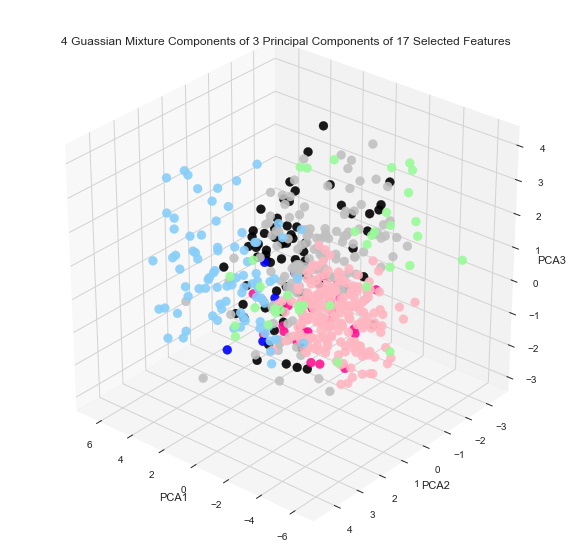

In [694]:
#Graph the 4 clusters of 3 components before they're passed into final model
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmrfe = []

    
gaus_pcarfe = GaussianMixture(n_components=4, random_state=0).fit_predict(pca_rf)
C = gaus_pcarfe.reshape(-1, 1)
Y = np.array(y).reshape(-1, 1)
#onehot_encoder = OneHotEncoder(sparse=False)
#B = onehot_encoder.fit_transform(C)
D = np.concatenate((Y,C, pca_rf), axis=1)
#D = np.concatenate((y,D), axis=1)

dots = []
for j in range(2):
    for i in range(4):
        print(D[(D[:,0]==j) & (D[:,1]==i)].shape[0])
        dots.append(D[(D[:,0]==j) & (D[:,1]==i)])
dots[0]

# This import registers the 3D projection, but is otherwise unused.
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')


for e, c in zip(dots, ['silver','lightskyblue','lightpink','palegreen','black','blue','deeppink','darkgreen']):
    #print(e[:,2])
    ax.scatter(e[:,2], e[:,3], e[:,4], c=c, marker='o', s=80, alpha=0.9)

ax.set_xlabel('PCA1')
ax.set_ylabel('PCA2')
ax.set_zlabel('PCA3')
ax.set_title('4 Guassian Mixture Components of 3 Principal Components of 17 Selected Features')
ax.view_init(azim=130)
ax.set_facecolor('white')
plt.rcParams['grid.color'] = "lightgrey"
plt.show()

In [609]:
#Gaussian on PCA on RFE Added to RFE-- Labels Plus DATA
y = df.iloc[:,0]
X = df.iloc[:,2:]

bestcv = 0.0
bestk = 0
listcvkmrfe = []

for k in range(5,6):
    
    gaus_pcarfe = GaussianMixture(n_components=k, random_state=0).fit_predict(pca_rf)
    C = gaus_pcarfe.reshape(-1, 1)
    onehot_encoder = OneHotEncoder(sparse=False)
    B = onehot_encoder.fit_transform(C)
    
    D = np.concatenate((B, selector), axis=1)

    #split data into 85% train, 15% test
    X_train, X_test, y_train, y_test = train_test_split(D, y, test_size=0.15, random_state=0)

    #Neural Network Grid Search------------------------------------------------------
    from sklearn.neural_network import MLPClassifier

    #create gridSearch parameters
    parameters = {'solver': ['lbfgs'], 'max_iter': [37], 'alpha': [1], 'hidden_layer_sizes':[4]}
    #run GridSearch to optimize parameters
    clf = GridSearchCV(MLPClassifier(random_state=0), param_grid=parameters, scoring='f1', cv=5, n_jobs=-1, verbose=3)
    clf.fit(X_train,y_train)

    #extract the best params from 'clf'
    best_hyperparams = clf.best_params_
    print(best_hyperparams)

    #extract best CV score 
    best_CV_score = clf.best_score_
    print(best_CV_score)

    if best_CV_score > bestcv:
        bestcv = best_CV_score
        bestk = k
    listcvkmrfe.append(best_CV_score)
print(bestcv)
print(bestk)
        
#extract best model from clf
best_nn = clf.best_estimator_

#Fit the model to the data
best = best_nn.fit(X_train,y_train)

#make predictions on test data
y_pred = best.predict(X_test)

#create confusion & classification matrix for test data
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred,digits=3))

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:363: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    3.0s remaining:    4.6s


{'alpha': 1, 'hidden_layer_sizes': 4, 'max_iter': 37, 'solver': 'lbfgs'}
0.4987881174216868
0.4987881174216868
5
[[71  1]
 [ 5  7]]
              precision    recall  f1-score   support

           0      0.934     0.986     0.959        72
           1      0.875     0.583     0.700        12

   micro avg      0.929     0.929     0.929        84
   macro avg      0.905     0.785     0.830        84
weighted avg      0.926     0.929     0.922        84



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    3.3s finished
C:\Users\e4129\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


In [ ]:
# data to plot
n_groups = 4
means_frank = (90, 55, 40, 65)
means_guido = (85, 62, 54, 20)
 
# create plot
fig, ax = plt.subplots()
index = np.arange(n_groups)
bar_width = 0.35
opacity = 0.8
 
rects1 = plt.bar(index, means_frank, bar_width,
alpha=opacity,
color='b',
label='Frank')
 
rects2 = plt.bar(index + bar_width, means_guido, bar_width,
alpha=opacity,
color='g',
label='Guido')
 
plt.xlabel('Person')
plt.ylabel('Scores')
plt.title('Scores by person')
plt.xticks(index + bar_width, ('A', 'B', 'C', 'D'))
plt.legend()
 
plt.tight_layout()
plt.show()